# Setup

### Imports

In [1]:
import itertools
import os
import sys
import pickle

sys.path.append("./ml-fastvit")

In [2]:
import timm
import torch
import torch.optim as optim
import torchvision.utils as vutils
import torchvision.transforms as T
import torch.nn as nn

# import models
import math
import matplotlib.pyplot as plt
import numpy as np
import gc

from torch import Tensor
from torch.nn import functional as F
from torchvision import datasets, transforms
from torch.utils.data import DataLoader
import torch.nn.init as init

# from timm.models import create_model
# from models.modules.mobileone import reparameterize_model
from PIL import Image
from urllib.request import urlopen
from sklearn.cluster import KMeans

from UpsampleTransformerDecoder import UpsampleTransformerDecoder
from Autoencoder import AvenueAutoencoder, CNNAutoencoder

import wandb

# Before starting the training, make sure to clear any residual memory
gc.collect()
torch.cuda.empty_cache()

device = "cuda" if torch.cuda.is_available() else "cpu"
print(device)

If for semantic segmentation, please install mmsegmentation first
If for detection, please install mmdetection first
cuda


In [3]:
from object_detection_utils import (
    COLORS,
    preprocess,
    box_cxcywh_to_xyxy,
    rescale_bboxes,
    batch_detect,
    detect,
    plot_results,
    plot_batch_detections,
    plot_batch_detections,
    # plot_results_avenue,
    plot_latent_representations,
    load_images_from_folder,
    list_files,
    list_image_files,
    save_cropped_images,
    imshow,
    plot_images_vs_reconstructed_images,
    load_artefact,
    get_directory_names,
)

from anomaly_detection_utils import (
    compute_fpr_rbdr,
    AnomalyDetection,
    process_current_vid_preds,
    read_txt_to_numpy_array,
    compute_macro_auc,
    compute_micro_auc,
    compute_anomaly_reconstruction_scores,
    GaussianNoiseDataset,
)

In [4]:
transform = T.Compose([T.Resize((64, 64)), T.ToTensor(), T.Normalize(0.5, 0.5)])

In [5]:
# Read pre-trained weights (on reconstruction loss) for model architecture
autoencoder_path = "autoencoder_t12_decoder_yolov8_2_adamw_numheads_8_ffdim_1024_numblocks_2_epoch_17_mseloss_0.0025767571664901574.pth"
autoencoder = AvenueAutoencoder(autoencoder_path).to(device)

In [6]:
# Freeze decoder weights
# for param in autoencoder.parameters():
#     param.requires_grad = False

# Experiment 1: K-Means - Failed, no benefits

## Avenue

In [11]:
torch.manual_seed(0)
train_dataset = datasets.ImageFolder(
    root="./datasets/Avenue Dataset/objects/train/", transform=transform
)

# Create the DataLoader to load the dataset.
batch_size = 32
train_loader = DataLoader(
    train_dataset, batch_size=batch_size, shuffle=True, num_workers=2, drop_last=True
)

print(train_dataset)

Dataset ImageFolder
    Number of datapoints: 127194
    Root location: ./datasets/Avenue Dataset/objects/train/
    StandardTransform
Transform: Compose(
               Resize(size=(64, 64), interpolation=bilinear, max_size=None, antialias=None)
               ToTensor()
               Normalize(mean=0.5, std=0.5)
           )


#### Compute Latent Representations and K-Means

In [12]:
# %%time
# latent_representations = None

# print("Computing Latents for K-Means...")
# with torch.no_grad():
#     for inputs, _ in train_loader:
#         inputs = inputs.to(device)

#         # Forward pass through the encoder
#         latents = autoencoder.encoder(inputs)

#         del inputs
#         torch.cuda.empty_cache()

#         # latent_tensor_2 = latents[1]
#         # latent_tensor_3 = latents[2]
#         last_latent_tensor = latents[-1]

#         # flattened_batch_2 = latent_tensor_2.view(latent_tensor_2.size(0), -1).detach().cpu().numpy()
#         # flattened_batch_3 = latent_tensor_3.view(latent_tensor_3.size(0), -1).detach().cpu().numpy()
#         flattened_batch_last = last_latent_tensor.view(last_latent_tensor.size(0), -1).detach().cpu().numpy()

#         # concatenated_batch = np.concatenate((flattened_batch_2, flattened_batch_3, flattened_batch_last), axis=1)
#         # concatenated_batch = np.concatenate((flattened_batch_3, flattened_batch_last), axis=1)

#         # Initialize or concatenate the results
#         if latent_representations is None:
#             # latent_representations = concatenated_batch
#             latent_representations = flattened_batch_last
#         else:
#             # latent_representations = np.concatenate((latent_representations, concatenated_batch), axis=0)
#             latent_representations = np.concatenate((latent_representations, flattened_batch_last), axis=0)

# print(latent_representations.shape)

- sa verific daca e aceeasi ordine intre train loader si cluster centers si labels (sa retin reprezentarile, fac o diferenta si iau argmin de cluster centers - mult mai safe)
- ai faza 1 de autoencoder simplu; faza 2 calculez centroizi din encoder (latent representations, cum am facut), as mai putea adauga inca un loss (KL-divergence) 

In [13]:
# %%time
# # del latents
# # torch.cuda.empty_cache()  # Clear unused memory

# # Perform K-means on these representations
# kmeans = KMeans(n_clusters=500, random_state=0, n_init="auto")
# # kmeans = KMeans(n_clusters=50, random_state=0, n_init="auto")
# kmeans.fit(latent_representations)
# cluster_labels = kmeans.labels_
# cluster_centers = kmeans.cluster_centers_

In [14]:
# import pickle
# # Specify the file name for storing the array
# file_name = "avenue_kmeans_500_2048.pkl"

# # Open the file in write-binary ('wb') mode and use pickle to dump the array
# with open(file_name, 'wb') as file:
#     pickle.dump(kmeans, file)
# print(f"K-Means successfully saved to {file_name}")

In [15]:
# import pickle
# # Specify the file name for storing the array
# file_name = "avenue_cluster_centers_num_500_2048.pkl"

# # Open the file in write-binary ('wb') mode and use pickle to dump the array
# with open(file_name, 'wb') as file:
#     pickle.dump(cluster_centers, file)
# print(f"Array successfully saved to {file_name}")

# # Specify the file name for storing the array
# file_name = "avenue_cluster_labels_num_500_2048.pkl"

# # Open the file in write-binary ('wb') mode and use pickle to dump the array
# with open(file_name, 'wb') as file:
#     pickle.dump(cluster_labels, file)

# print(f"Array successfully saved to {file_name}")

In [16]:
# # Load the array back from the file
# import pickle
# # file_name = "avenue_cluster_centers_num_500_6144.pkl"
# clusters_name = "avenue_cluster_centers_num_500_2048.pkl"
# label_name = "avenue_cluster_labels_num_500_2048.pkl"

# with open(clusters_name, 'rb') as file:
#     cluster_centers = pickle.load(file)

# with open(label_name, 'rb') as file:
#     cluster_labels = pickle.load(file)

# print("Loaded array:", cluster_centers.shape)
# print("Loaded array:", cluster_labels.shape)

#### TODO: UBNormal Abnormal Latent Representations (With Avenue Autoencoder)

In [ ]:
torch.manual_seed(0)
train_abnormal_dataset = datasets.ImageFolder(
    root="./datasets/Avenue Dataset/objects/train/", transform=transform
)

# Create the DataLoader to load the dataset.
batch_size = 32
train_abormal_loader = DataLoader(
    train_abnormal_dataset,
    batch_size=batch_size,
    shuffle=True,
    num_workers=2,
    drop_last=True,
)

print(train_dataset)

#### Setup Loss and Optimizer

In [12]:
# Set up loss function and optimizer
criterion = nn.MSELoss()
# optimizer = optim.SGD(autoencoder.parameters(), lr=0.01, momentum=0.9)
# optimizer.load_state_dict(torch.load(autoencoder_path)['optimizer_state_dict'])
optimizer = optim.AdamW(autoencoder.parameters(), lr=0.001)

# Define the triplet loss function
# criterion = nn.TripletMarginLoss(margin=1.0, p=2)

# autoencoder = torch.compile(autoencoder)

#### Corect setup

In [13]:
%%time
# TODO ulterior: Sa il fortez sa mearga catre cluster-ul predeterminat, sa am un dict cu imagine si latent representation pt K-Means
latent_representations = None
autoencoder.eval()

print("Computing Latents for K-Means...")
with torch.no_grad():
    for inputs, _ in train_loader:
        inputs = inputs.to(device)

        # Forward pass through the encoder
        latents = autoencoder.encoder(inputs)

        last_latent_tensor = latents[-1]

        # Pot sa fac flatten
        flattened_batch_last = (
            last_latent_tensor.view(last_latent_tensor.size(0), -1)
            .detach()
            .cpu()
            .numpy()
        )

        # Initialize or concatenate the results (numpy append is actually slower)
        if latent_representations is None:
            # latent_representations = concatenated_batch
            latent_representations = flattened_batch_last
        else:
            # latent_representations = np.concatenate((latent_representations, concatenated_batch), axis=0)
            latent_representations = np.concatenate(
                (latent_representations, flattened_batch_last), axis=0
            )

        # del inputs
        # torch.cuda.empty_cache()

print(latent_representations.shape)

Computing Latents for K-Means...
(127168, 2048)
CPU times: user 2min 54s, sys: 1min 51s, total: 4min 46s
Wall time: 4min 56s


In [14]:
%%time
# del latents
# torch.cuda.empty_cache()  # Clear unused memory
num_clusters = 500
# Perform K-means on these representations
# kmeans = KMeans(n_clusters=500, random_state=0, n_init="auto")
kmeans = KMeans(n_clusters=num_clusters, random_state=707, n_init="auto")
kmeans.fit(latent_representations)
cluster_labels = kmeans.labels_
cluster_centers = kmeans.cluster_centers_  # (50, 2048) -> ii las in numpy

CPU times: user 27min 47s, sys: 59min 13s, total: 1h 27min 1s
Wall time: 7min 44s


In [15]:
import pickle

# Specify the file name for storing the array
file_name = "avenue_kmeans_500_2048.pkl"

# Open the file in write-binary ('wb') mode and use pickle to dump the array
with open(file_name, "wb") as file:
    pickle.dump(kmeans, file)
print(f"K-Means successfully saved to {file_name}")

K-Means successfully saved to avenue_kmeans_500_2048.pkl


In [16]:
# Set up loss function and optimizer
# criterion = nn.MSELoss()
# optimizer = optim.SGD(autoencoder.parameters(), lr=0.01, momentum=0.9)
# optimizer.load_state_dict(torch.load(autoencoder_path)['optimizer_state_dict'])
optimizer = optim.AdamW(autoencoder.parameters(), lr=0.001)
criterion = nn.MSELoss()
# Define the triplet loss function
# criterion = nn.TripletMarginLoss(margin=1.0, p=2)

# autoencoder = torch.compile(autoencoder)

#### KMeans keep clusters in-place

In [17]:
import copy

frozen_ae = copy.deepcopy(autoencoder)
frozen_ae = frozen_ae.to(device)
frozen_ae.eval()

Autoencoder(
  (encoder): FastViT(
    (patch_embed): Sequential(
      (0): MobileOneBlock(
        (se): Identity()
        (activation): GELU(approximate='none')
        (reparam_conv): Conv2d(3, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      )
      (1): MobileOneBlock(
        (se): Identity()
        (activation): GELU(approximate='none')
        (reparam_conv): Conv2d(64, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), groups=64)
      )
      (2): MobileOneBlock(
        (se): Identity()
        (activation): GELU(approximate='none')
        (reparam_conv): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1))
      )
    )
    (network): ModuleList(
      (0): Sequential(
        (0): RepMixerBlock(
          (token_mixer): RepMixer(
            (reparam_conv): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=64)
          )
          (convffn): ConvFFN(
            (conv): Sequential(
              (conv): Conv2d(64, 64, kernel_size=(7

#### Reconstruction MSE + Classification Cluster Loss 

In [51]:
# class ModifiedAutoencoder(nn.Module):
#     def __init__(self, original_autoencoder, num_clusters):
#         super(ModifiedAutoencoder, self).__init__()
#         self.encoder = original_autoencoder.encoder
#         self.decoder = original_autoencoder.decoder
#         # Assuming last_latent_tensor is of shape [batch_size, 512, 2, 2]
#         # Flatten it and add a fully connected layer for classification
#         self.fc = nn.Linear(512 * 2 * 2, num_clusters)

#     def forward(self, x):
#         latents = self.encoder(x)
#         last_latent_tensor = latents[-1]
#         flattened = last_latent_tensor.view(last_latent_tensor.size(0), -1)
#         logits = self.fc(flattened)
#         reconstructed = self.decoder(last_latent_tensor)
#         return logits, reconstructed

In [52]:
# # Training loop
# num_epochs = 20  # Define the number of epochs

# # Convert cluster data to tensors
# cluster_centers_tensor = torch.Tensor(cluster_centers).float().to(device)
# # cluster_labels_tensor = torch.Tensor(cluster_labels).long().to(device)

# losses = []
# # smallest_loss = 3

# # start a new wandb run to track this script
# # run = wandb.init(
# #     # set the wandb project where this run will be logged
# #     project="Anomaly Detection",

# #     # track hyperparameters and run metadata
# #     config={
# #         "task": "K Means",
# #         "num_clusters": num_clusters,
# #         "encoder": "T12",
# #         "decoder": f"{decoder.__class__}",
# #         "dataset": "Avenue",
# #         "predictions": "YoloV8",
# #         "epochs": f"{num_epochs}",
# #         "input_channels": f"{input_channels}",
# #         "num_upsamples": f"{num_upsamples}",
# #         "num_blocks": f"{num_blocks}",
# #         "num_heads": f"{num_heads}",
# #         "ff_dim": f"{ff_dim}",
# #         "output_channels": f"{output_channels}"
# #     }
# # )

# # Instantiate your modified autoencoder
# modif_ae = ModifiedAutoencoder(autoencoder, num_clusters=50)
# modif_ae = modif_ae.to(device)
# modif_ae.train()

# optimizer = optim.AdamW(modif_ae.parameters(), lr=0.001)
# criterion_reconstruction = nn.MSELoss()
# criterion_classification = nn.CrossEntropyLoss()

# for epoch in range(num_epochs):
#     running_loss = 0.0

#     for inputs, _ in train_loader:
#         optimizer.zero_grad()
#         inputs = inputs.to(device)

#         # Forward pass through the modified autoencoder
#         logits, reconstructed_imgs = modif_ae(inputs)
#         # print(logits.shape)
#         logits = logits.type(torch.LongTensor).to(device)

#         # Get the predicted classes for each example in the batch
#         predicted_labels = torch.argmax(logits, dim=1)
#         predicted_labels = predicted_labels.type(torch.LongTensor).to(device)

#         # Classification loss
#         # frozen_ae_latents = frozen_ae.encoder(inputs)
#         # last_frozen_ae_tensor = frozen_ae_latents[-1]
#         # last_frozen_ae_tensor_np = last_frozen_ae_tensor.view(last_frozen_ae_tensor.size(0), -1).detach().cpu().numpy()
#         # batch_labels_np = kmeans.predict(last_frozen_ae_tensor_np)
#         # batch_labels_tensor = torch.tensor(batch_labels_np).to(device)

#         latents = modif_ae.encoder(inputs)
#         last_ae_tensor = latents[-1]
#         last_ae_tensor_np = last_ae_tensor.view(last_ae_tensor.size(0), -1).detach().cpu().numpy()
#         batch_labels_np = kmeans.predict(last_ae_tensor_np)
#         batch_labels_tensor = torch.tensor(batch_labels_np).to(device)

#         classification_loss = criterion_classification(predicted_labels.float(), batch_labels_tensor.float())

#         # Reconstruction loss
#         reconstruction_loss = criterion_reconstruction(inputs, reconstructed_imgs)

#         # Combine the losses
#         loss = classification_loss + reconstruction_loss

#         loss.backward()
#         optimizer.step()

#         running_loss += loss.item()
#         losses.append(loss.item())

#    # Save checkpoint
#     checkpoint = {
#         'epoch': epoch + 1,
#         'encoder_state_dict': autoencoder.encoder.state_dict(),
#         'decoder_state_dict': autoencoder.decoder.state_dict(),
#         'optimizer_state_dict': optimizer.state_dict(),
#         'loss': running_loss / len(train_loader)
#     }
#     torch.save(checkpoint, f'autoencoder_avenue_clasif_loss_t12_decoder_yolov8_clusters_{num_clusters}_adamw_numheads_{num_heads}_ffdim_{ff_dim}_numblocks_{num_blocks}_epoch_{epoch+1}_kmeans_loss_{running_loss / len(train_loader)}.pth')

#     # run.log({"Loss": running_loss / len(train_loader), "epoch": epoch+1})
#     # Print loss every epoch
#     print(f'Epoch {epoch+1}, Loss: {running_loss / len(train_loader)}')

Epoch 1, Loss: 2053.951288907685
Epoch 2, Loss: 2052.3299509863427


KeyboardInterrupt: 

#### Reconstruction MSE + Cluster Loss MSE

In [18]:
autoencoder.train()

# Training loop
num_epochs = 20  # Define the number of epochs

# Convert cluster data to tensors
cluster_centers_tensor = torch.Tensor(cluster_centers).float().to(device)
# cluster_labels_tensor = torch.Tensor(cluster_labels).long().to(device)

losses = []
# smallest_loss = 3

# start a new wandb run to track this script
run = wandb.init(
    # set the wandb project where this run will be logged
    project="Anomaly Detection",
    # track hyperparameters and run metadata
    config={
        "task": "K Means",
        "num_clusters": num_clusters,
        "encoder": "T12",
        "decoder": f"{decoder.__class__}",
        "dataset": "Avenue",
        "predictions": "YoloV8",
        "epochs": f"{num_epochs}",
        "input_channels": f"{input_channels}",
        "num_upsamples": f"{num_upsamples}",
        "num_blocks": f"{num_blocks}",
        "num_heads": f"{num_heads}",
        "ff_dim": f"{ff_dim}",
        "output_channels": f"{output_channels}",
    },
)

for epoch in range(num_epochs):
    running_loss = 0.0
    batch_idx = 0

    for inputs, _ in train_loader:
        optimizer.zero_grad()
        inputs = inputs.to(device)
        latents = autoencoder.encoder(inputs)
        last_latent_tensor = latents[-1]  # [batch_size, 512, 2, 2]

        # Get the tensor into numpy under the shape [batch_size, 2048] -> (32, 2048) to get the fixed label before training
        frozen_ae_latents = frozen_ae.encoder(inputs)
        last_frozen_ae_tensor = frozen_ae_latents[-1]
        last_frozen_ae_tensor_np = (
            last_frozen_ae_tensor.view(last_latent_tensor.size(0), -1)
            .detach()
            .cpu()
            .numpy()
        )

        # Get centroid label for each sample -> (32, )
        batch_labels_np = kmeans.predict(last_frozen_ae_tensor_np)

        # Get corresponding centroids for each label -> [batch_size, 2048]
        corresponding_centroids = cluster_centers_tensor[batch_labels_np]

        # Compute distance between each sample's latent layer and corresponding centroid, under shape [batch_size, 512, 2, 2]
        cluster_loss = criterion(
            last_latent_tensor, corresponding_centroids.view(batch_size, 512, 2, 2)
        )

        # TODO: Cosine Loss

        # # Adversarial loss
        # cluster_loss = 1 - cluster_loss

        # -- Reconstruction loss --
        reconstructed_imgs = autoencoder.decoder(last_latent_tensor)
        reconstruction_loss = criterion(inputs, reconstructed_imgs)
        loss = cluster_loss + reconstruction_loss

        # Only cluster loss
        # loss = cluster_loss

        loss.backward()
        optimizer.step()

        running_loss += loss.item()
        losses.append(loss.item())

        # batch_idx += batch_size

    # if running_loss / len(train_loader) < smallest_loss:
    #     smallest_loss = running_loss / len(train_loader)
    # Save checkpoint
    checkpoint = {
        "epoch": epoch + 1,
        "encoder_state_dict": autoencoder.encoder.state_dict(),
        "decoder_state_dict": autoencoder.decoder.state_dict(),
        "optimizer_state_dict": optimizer.state_dict(),
        "loss": running_loss / len(train_loader),
    }
    torch.save(
        checkpoint,
        f"autoencoder_avenue_recon_and_cluster_t12_decoder_yolov8_clusters_{num_clusters}_adamw_numheads_{num_heads}_ffdim_{ff_dim}_numblocks_{num_blocks}_epoch_{epoch+1}_kmeans_loss_{running_loss / len(train_loader)}.pth",
    )

    run.log({"Loss": running_loss / len(train_loader), "epoch": epoch + 1})
    # Print loss every epoch
    print(f"Epoch {epoch+1}, Loss: {running_loss / len(train_loader)}")

    # torch.cuda.empty_cache()  # Clear unused memory

print("Finished Training")
run.finish()

wandb: Currently logged in as: thesergiu. Use `wandb login --relogin` to force relogin


Epoch 1, Loss: 0.008971905143965255
Epoch 2, Loss: 0.007289404129430419
Epoch 3, Loss: 0.00654047029362415
Epoch 4, Loss: 0.005974442026754592
Epoch 5, Loss: 0.005544406286826067
Epoch 6, Loss: 0.005244059606643218
Epoch 7, Loss: 0.004968392734826417
Epoch 8, Loss: 0.0047122033830370265
Epoch 9, Loss: 0.004565552579614915
Epoch 10, Loss: 0.004390551662998237
Epoch 11, Loss: 0.004248856327160874
Epoch 12, Loss: 0.00413321076892785
Epoch 13, Loss: 0.004025426868498831
Epoch 14, Loss: 0.003947942399173304
Epoch 15, Loss: 0.0038665267683389384
Epoch 16, Loss: 0.003805207526069894
Epoch 17, Loss: 0.003749049783890076
Epoch 18, Loss: 0.003679091592657248
Epoch 19, Loss: 0.0036277386671444
Epoch 20, Loss: 0.003609325802790317
Finished Training


Loss,█▆▅▄▄▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁
epoch,▁▁▂▂▂▃▃▄▄▄▅▅▅▆▆▇▇▇██
Loss,0.00361
epoch,20


#### KMeans Predict on current latent

In [17]:
autoencoder.train()

# Training loop
num_epochs = 20  # Define the number of epochs

# Convert cluster data to tensors
cluster_centers_tensor = torch.Tensor(cluster_centers).float().to(device)
# cluster_labels_tensor = torch.Tensor(cluster_labels).long().to(device)

losses = []
# smallest_loss = 3

# start a new wandb run to track this script
run = wandb.init(
    # set the wandb project where this run will be logged
    project="Anomaly Detection",
    # track hyperparameters and run metadata
    config={
        "task": "K Means",
        "num_clusters": num_clusters,
        "encoder": "T12",
        "decoder": f"{decoder.__class__}",
        "dataset": "Avenue",
        "predictions": "YoloV8",
        "epochs": f"{num_epochs}",
        "input_channels": f"{input_channels}",
        "num_upsamples": f"{num_upsamples}",
        "num_blocks": f"{num_blocks}",
        "num_heads": f"{num_heads}",
        "ff_dim": f"{ff_dim}",
        "output_channels": f"{output_channels}",
    },
)

for epoch in range(num_epochs):
    running_loss = 0.0
    batch_idx = 0

    for inputs, _ in train_loader:
        optimizer.zero_grad()
        inputs = inputs.to(device)
        latents = autoencoder.encoder(inputs)
        last_latent_tensor = latents[-1]  # [batch_size, 512, 2, 2]

        # Get the tensor into numpy under the shape [batch_size, 2048] -> (32, 2048)
        last_latent_tensor_np = (
            last_latent_tensor.clone()
            .view(last_latent_tensor.size(0), -1)
            .detach()
            .cpu()
            .numpy()
        )

        # Get centroid label for each sample -> (32, )
        batch_labels_np = kmeans.predict(last_latent_tensor_np)

        # Get corresponding centroids for each label -> [batch_size, 2048]
        corresponding_centroids = cluster_centers_tensor[batch_labels_np]

        # Compute distance between each sample's latent layer and corresponding centroid, under shape [batch_size, 512, 2, 2]
        cluster_loss = criterion(
            last_latent_tensor, corresponding_centroids.view(batch_size, 512, 2, 2)
        )

        # # Fac o copie, il trec ca numpy -> 32, 2048
        # last_latent_tensor_np = np.expand_dim(last_latent_tensor.copy().detach().cpu().numpy(), 1) # 32, 1, 2048

        # batch_cluster_labels = cluster_centers # replicate [batch_size, 50, 2048]

        # # pot sa obtin si cu predict
        # batch_cluster_labels = np.abs(cluster_centers - last_latent_tensor_np).sum(-1).argmin(1) # (32, 50)

        # batch_cluster_labels = cluster_centers[batch_cluster_labels] # torch.tensor().float() etc

        # # latent_representation_tensor = last_latent_tensor.view(last_latent_tensor.size(0), -1)

        # # Get the cluster assignments for the current batch
        # # batch_cluster_labels = cluster_labels[batch_idx:batch_idx + batch_size]
        # # batch_cluster_labels_tensor = torch.Tensor(batch_cluster_labels).long().to(device)

        # # Get corresponding centroids
        # # corresponding_centroids = cluster_centers_tensor[batch_cluster_labels_tensor]

        # # Incerc MSE, MAE si abia dupa KL divergence, etc.
        # loss_centroids = criterion(last_latent_tensor.view(last_latent_tensor.size(0), -1), batch_cluster_labels)

        # -- Reconstruction loss --
        reconstructed_imgs = autoencoder.decoder(last_latent_tensor)
        reconstruction_loss = criterion(inputs, reconstructed_imgs)
        loss = cluster_loss + reconstruction_loss

        # Only cluster loss
        # loss = cluster_loss

        loss.backward()
        optimizer.step()

        running_loss += loss.item()
        losses.append(loss.item())

        # batch_idx += batch_size

    # if running_loss / len(train_loader) < smallest_loss:
    #     smallest_loss = running_loss / len(train_loader)
    # Save checkpoint
    checkpoint = {
        "epoch": epoch + 1,
        "encoder_state_dict": autoencoder.encoder.state_dict(),
        "decoder_state_dict": autoencoder.decoder.state_dict(),
        "optimizer_state_dict": optimizer.state_dict(),
        "loss": running_loss / len(train_loader),
    }
    torch.save(
        checkpoint,
        f"autoencoder_avenue_cluster_and_recon_t12_decoder_yolov8_clusters_{num_clusters}_adamw_numheads_{num_heads}_ffdim_{ff_dim}_numblocks_{num_blocks}_epoch_{epoch+1}_kmeans_loss_{running_loss / len(train_loader)}.pth",
    )

    run.log({"Loss": running_loss / len(train_loader), "epoch": epoch + 1})
    # Print loss every epoch
    print(f"Epoch {epoch+1}, Loss: {running_loss / len(train_loader)}")

    # torch.cuda.empty_cache()  # Clear unused memory

print("Finished Training")
run.finish()

wandb: Currently logged in as: thesergiu. Use `wandb login --relogin` to force relogin


Epoch 1, Loss: 0.0005627488494503864
Epoch 2, Loss: 1.336788872280613e-07
Epoch 3, Loss: 9.670296271715024e-08
Epoch 4, Loss: 7.83454006706949e-08
Epoch 5, Loss: 6.98504740090192e-08
Epoch 6, Loss: 6.474740039478064e-08
Epoch 7, Loss: 6.441973468318412e-08
Epoch 8, Loss: 6.11523550778133e-08
Epoch 9, Loss: 5.946973641768511e-08
Epoch 10, Loss: 6.167508398271e-08
Epoch 11, Loss: 6.042968792307056e-08
Epoch 12, Loss: 6.136998033701242e-08
Epoch 13, Loss: 6.204589730356878e-08
Epoch 14, Loss: 6.212843151951198e-08
Epoch 15, Loss: 6.51130678202705e-08
Epoch 16, Loss: 6.202547511468891e-08
Epoch 17, Loss: 6.463224768188294e-08
Epoch 18, Loss: 6.325243723731993e-08
Epoch 19, Loss: 6.741095747554194e-08
Epoch 20, Loss: 6.556030938231856e-08
Finished Training


Loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,▁▁▂▂▂▃▃▄▄▄▅▅▅▆▆▇▇▇██
Loss,0.0
epoch,20


#### Latent Space based Loss (MSE)

In [22]:
criterion = nn.MSELoss()

# Training loop
num_epochs = 20  # Define the number of epochs
num_clusters = 500
# Convert cluster data to tensors
cluster_centers_tensor = torch.Tensor(cluster_centers).float().to(device)
cluster_labels_tensor = torch.Tensor(cluster_labels).long().to(device)

losses = []
# smallest_loss = 3

# start a new wandb run to track this script
run = wandb.init(
    # set the wandb project where this run will be logged
    project="Anomaly Detection",
    # track hyperparameters and run metadata
    config={
        "task": "K Means",
        "num_clusters": num_clusters,
        "encoder": "T12",
        "decoder": f"{decoder.__class__}",
        "dataset": "Avenue",
        "predictions": "YoloV8",
        "epochs": f"{num_epochs}",
        "input_channels": f"{input_channels}",
        "num_upsamples": f"{num_upsamples}",
        "num_blocks": f"{num_blocks}",
        "num_heads": f"{num_heads}",
        "ff_dim": f"{ff_dim}",
        "output_channels": f"{output_channels}",
    },
)

for epoch in range(num_epochs):
    running_loss = 0.0
    batch_idx = 0

    for inputs, _ in train_loader:
        optimizer.zero_grad()
        inputs = inputs.to(device)
        latents = autoencoder.encoder(inputs)
        last_latent_tensor = latents[-1]

        latent_representation_tensor = last_latent_tensor.view(
            last_latent_tensor.size(0), -1
        )

        # Get the cluster assignments for the current batch
        batch_cluster_labels = cluster_labels[batch_idx : batch_idx + batch_size]
        batch_cluster_labels_tensor = (
            torch.Tensor(batch_cluster_labels).long().to(device)
        )

        # Get corresponding centroids
        corresponding_centroids = cluster_centers_tensor[batch_cluster_labels_tensor]

        loss = criterion(latent_representation_tensor, corresponding_centroids)

        loss.backward()
        optimizer.step()

        running_loss += loss.item()
        losses.append(loss.item())

        batch_idx += batch_size

    # if running_loss / len(train_loader) < smallest_loss:
    #     smallest_loss = running_loss / len(train_loader)
    # Save checkpoint
    checkpoint = {
        "epoch": epoch + 1,
        "encoder_state_dict": autoencoder.encoder.state_dict(),
        "decoder_state_dict": autoencoder.decoder.state_dict(),
        "optimizer_state_dict": optimizer.state_dict(),
        "loss": running_loss / len(train_loader),
    }
    torch.save(
        checkpoint,
        f"autoencoder_t12_decoder_yolov8_clusters_{num_clusters}_adamw_numheads_{num_heads}_ffdim_{ff_dim}_numblocks_{num_blocks}_epoch_{epoch+1}_kmeans_loss_{running_loss / len(train_loader)}.pth",
    )

    # run.log({"Loss": loss, "epoch": epoch+1})
    # Print loss every epoch
    print(f"Epoch {epoch+1}, Loss: {running_loss / len(train_loader)}")

    torch.cuda.empty_cache()  # Clear unused memory

print("Finished Training")
run.finish()

Epoch 1, Loss: 0.019145933427497798
Epoch 2, Loss: 0.018299335959050138
Epoch 3, Loss: 0.018295011939185615
Epoch 4, Loss: 0.01829286586520439



KeyboardInterrupt



#### Output based reconstruction (Triplet loss)

In [16]:
# Training loop
num_epochs = 20  # Define the number of epochs
num_clusters = 500
# Convert cluster data to tensors
cluster_centers_tensor = torch.Tensor(cluster_centers).float().to(device)
cluster_labels_tensor = torch.Tensor(cluster_labels).long().to(device)

losses = []
# smallest_loss = 3

# start a new wandb run to track this script
run = wandb.init(
    # set the wandb project where this run will be logged
    project="Anomaly Detection",
    # track hyperparameters and run metadata
    config={
        "task": "K Means",
        "num_clusters": num_clusters,
        "encoder": "T12",
        "decoder": f"{decoder.__class__}",
        "dataset": "Avenue",
        "predictions": "YoloV8",
        "epochs": f"{num_epochs}",
        "input_channels": f"{input_channels}",
        "num_upsamples": f"{num_upsamples}",
        "num_blocks": f"{num_blocks}",
        "num_heads": f"{num_heads}",
        "ff_dim": f"{ff_dim}",
        "output_channels": f"{output_channels}",
    },
)

for epoch in range(num_epochs):
    running_loss = 0.0
    batch_idx = 0

    for inputs, _ in train_loader:
        optimizer.zero_grad()
        inputs = inputs.to(device)
        latents = autoencoder.encoder(inputs)
        last_latent_tensor = latents[-1]

        # Get the cluster assignments for the current batch
        batch_cluster_labels = cluster_labels[batch_idx : batch_idx + batch_size]
        batch_cluster_labels_tensor = (
            torch.Tensor(batch_cluster_labels).long().to(device)
        )

        # Get corresponding centroids
        corresponding_centroids = cluster_centers_tensor[batch_cluster_labels_tensor]
        corresponding_centroids_reshaped = corresponding_centroids.view(
            batch_size, 512, 2, 2
        )

        # Create reconstructed images from centroid representations
        reconstructed_centroids = autoencoder.decoder(corresponding_centroids_reshaped)
        reconstructed_imgs = autoencoder.decoder(latents[-1])

        # Compute triplet loss
        loss = criterion(inputs, reconstructed_centroids, reconstructed_imgs)

        loss.backward()
        optimizer.step()

        running_loss += loss.item()
        losses.append(loss.item())

        batch_idx += batch_size

    # if running_loss / len(train_loader) < smallest_loss:
    #     smallest_loss = running_loss / len(train_loader)
    # Save checkpoint
    checkpoint = {
        "epoch": epoch + 1,
        "encoder_state_dict": autoencoder.encoder.state_dict(),
        "decoder_state_dict": autoencoder.decoder.state_dict(),
        "optimizer_state_dict": optimizer.state_dict(),
        "loss": running_loss / len(train_loader),
    }
    torch.save(
        checkpoint,
        f"autoencoder_t12_decoder_yolov8_clusters_{num_clusters}_adamw_numheads_{num_heads}_ffdim_{ff_dim}_numblocks_{num_blocks}_epoch_{epoch+1}_kmeans_loss_{running_loss / len(train_loader)}.pth",
    )

    # run.log({"Loss": loss, "epoch": epoch+1})
    # Print loss every epoch
    print(f"Epoch {epoch+1}, Loss: {running_loss / len(train_loader)}")

    torch.cuda.empty_cache()  # Clear unused memory

print("Finished Training")
run.finish()

wandb: Currently logged in as: thesergiu. Use `wandb login --relogin` to force relogin


Epoch 1, Loss: 0.011987469499052866
Epoch 2, Loss: 0.00038030486813118763
Epoch 3, Loss: 2.5793129360992037e-05
Epoch 4, Loss: 7.527725591567994e-05
Epoch 5, Loss: 9.025024699737171e-07



KeyboardInterrupt



In [ ]:
checkpoint = {
    "epoch": epoch + 1,
    "encoder_state_dict": autoencoder.encoder.state_dict(),
    "decoder_state_dict": autoencoder.decoder.state_dict(),
    "optimizer_state_dict": optimizer.state_dict(),
    "loss": running_loss / len(train_loader),
}
torch.save(
    checkpoint,
    f"autoencoder_t12_decoder_yolov8_clusters_{num_clusters}_adamw_numheads_{num_heads}_ffdim_{ff_dim}_numblocks_{num_blocks}_epoch_{epoch+1}_kmeans_loss_{running_loss / len(train_loader)}.pth",
)

### Reconstruction on Test Set Before 

In [14]:
test_dataset = datasets.ImageFolder(
    root="./datasets/Avenue Dataset/objects/test/", transform=transform
)

# Create the DataLoader to load the dataset.
test_loader = DataLoader(test_dataset, batch_size=64, shuffle=True, num_workers=2)

print(test_dataset)

Dataset ImageFolder
    Number of datapoints: 118881
    Root location: ./datasets/Avenue Dataset/objects/test/
    StandardTransform
Transform: Compose(
               Resize(size=(64, 64), interpolation=bilinear, max_size=None, antialias=None)
               ToTensor()
               Normalize(mean=0.5, std=0.5)
           )


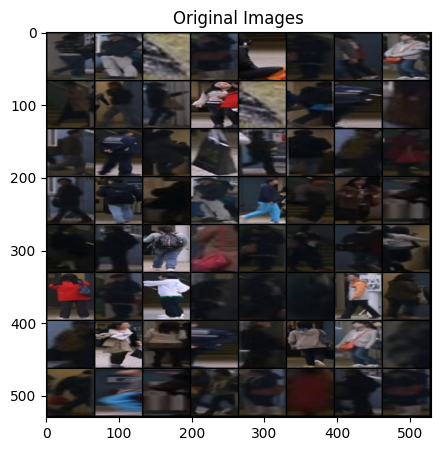

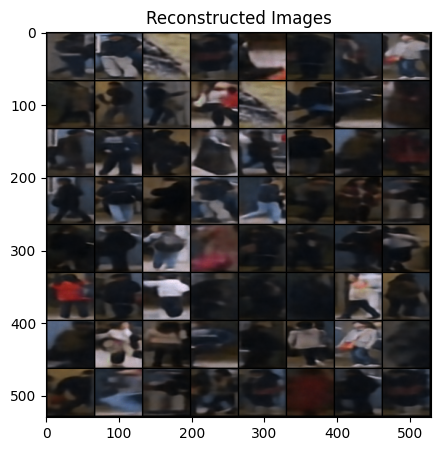

In [15]:
# Get a batch of images from your dataloader
dataiter = iter(test_loader)  # or your specific dataloader
images, labels = next(dataiter)

# Move images to the device your model is on
images = images.to(device)

# Forward pass through encoder and then decoder
with torch.no_grad():  # We don't need to track gradients for the encoder
    # latent_representation = encoder(images)[-1]  # Get the last latent space representation
    # reconstructed_imgs = decoder(latent_representation)
    reconstructed_imgs = autoencoder(images)

plot_images_vs_reconstructed_images(images, reconstructed_imgs)

### Reconstruction on Test Set After

In [16]:
# # Avenue
autoencoder_path = "autoencoder_t12_decoder_yolov8_clusters_500_adamw_numheads_8_ffdim_1024_numblocks_2_epoch_19_kmeans_loss_2.4447238031001104e-12.pth"
input_channels = 512
num_upsamples = 5
num_blocks = 2
num_heads = 8
ff_dim = 1024
output_channels = 3
decoder = UpsampleTransformerDecoder(
    input_channels=input_channels,
    num_upsamples=num_upsamples,  # Adjusted to 5 upsampling steps
    num_blocks=num_blocks,
    num_heads=num_heads,
    ff_dim=ff_dim,
    output_channels=output_channels,
    # use_positional_encoding=True
)

# # Shanghaitech
# autoencoder_path = 'shanghaitech_autoencoder_t12_decoder_yolov8_2_adamw_numheads_8_ffdim_2048_numblocks_1_epoch_17_mseloss_0.0027697434455824254.pth'

# UBnormal
# autoencoder_path = 'ubnormal_autoencoder_t12_decoder_yolov8_adamw_numheads_8_ffdim_2048_numblocks_2_epoch_29_mseloss_0.005403553107745176.pth'

encoder.load_state_dict(torch.load(autoencoder_path)["encoder_state_dict"])
decoder.load_state_dict(torch.load(autoencoder_path)["decoder_state_dict"])

<All keys matched successfully>

In [17]:
class Autoencoder(nn.Module):
    def __init__(self):
        super(Autoencoder, self).__init__()
        self.encoder = encoder
        self.decoder = decoder

    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x[-1])
        return x


autoencoder = Autoencoder()
autoencoder = autoencoder.to(device)

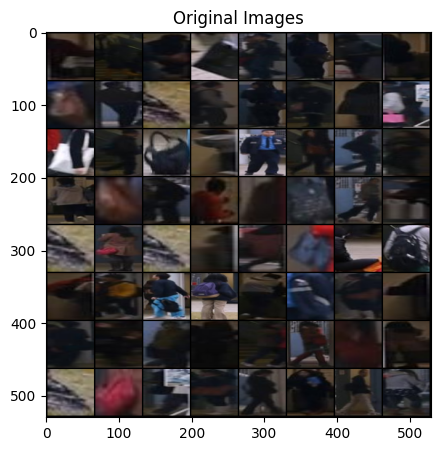

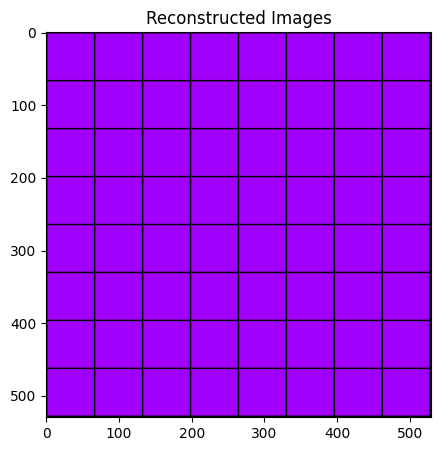

In [18]:
# Get a batch of images from your dataloader
dataiter = iter(test_loader)  # or your specific dataloader
images, labels = next(dataiter)

# Move images to the device your model is on
images = images.to(device)

# Forward pass through encoder and then decoder
with torch.no_grad():  # We don't need to track gradients for the encoder
    # latent_representation = encoder(images)[-1]  # Get the last latent space representation
    # reconstructed_imgs = decoder(latent_representation)
    reconstructed_imgs = autoencoder(images)

plot_images_vs_reconstructed_images(images, reconstructed_imgs)

### TODO: Automating the Search for best K using new comparison

In [ ]:
# %%time
from sklearn.cluster import KMeans

# Training loop
num_epochs = 35  # Define the number of epochs

for num_clusters in [250]:
    # num_clusters = 10
    losses = []
    smallest_loss = 5
    print(f"---NUM CLUSTERS: {num_clusters}--")

    encoder.load_state_dict(torch.load(autoencoder_path)["encoder_state_dict"])
    decoder.load_state_dict(torch.load(autoencoder_path)["decoder_state_dict"])

    class Autoencoder(nn.Module):
        def __init__(self):
            super(Autoencoder, self).__init__()
            self.encoder = encoder
            self.decoder = decoder

        def forward(self, x):
            x = self.encoder(x)
            x = self.decoder(x[-1])
            return x

    autoencoder = Autoencoder()
    autoencoder = autoencoder.to(device)

    # Set up loss function and optimizer
    criterion = nn.MSELoss()
    optimizer = optim.AdamW(autoencoder.parameters(), lr=0.001)

    # start a new wandb run to track this script
    run = wandb.init(
        # set the wandb project where this run will be logged
        project="Anomaly Detection",
        # track hyperparameters and run metadata
        config={
            "task": "K Means",
            "num_clusters": num_clusters,
            "encoder": "T12",
            "decoder": f"{decoder.__class__}",
            "dataset": "Avenue",
            "predictions": "YoloV8",
            "epochs": f"{num_epochs}",
            "input_channels": f"{input_channels}",
            "num_upsamples": f"{num_upsamples}",
            "num_blocks": f"{num_blocks}",
            "num_heads": f"{num_heads}",
            "ff_dim": f"{ff_dim}",
            "output_channels": f"{output_channels}",
        },
    )

    for epoch in range(num_epochs):
        running_loss = 0.0
        latent_representations = []

        # print(f"Epoch: {epoch}\nComputing Latents for K-Means...")
        for inputs, _ in train_loader:  # Ignore the labels
            inputs = inputs.to(device)  # Move inputs to the device

            # Forward pass through the encoder
            latents = autoencoder.encoder(inputs)  # If this returns a list of tensors

            del inputs
            torch.cuda.empty_cache()  # Clear unused memory

            # Assuming the last tensor in the list is the one we're interested in
            last_latent_tensor = latents[
                -1
            ]  # This should be a tensor of shape [batch_size, 512, 2, 2]

            # Loop over each sample in the batch
            for i in range(
                last_latent_tensor.size(0)
            ):  # Iterate over the batch dimension
                # Extract the latent representation for each sample and store it
                latent_sample = (
                    last_latent_tensor[i].flatten().detach().cpu().numpy()
                )  # latent_sample is of shape [512, 2, 2]
                latent_representations.append(latent_sample)

        del latents
        torch.cuda.empty_cache()  # Clear unused memory

        # Perform K-means on these representations
        kmeans = KMeans(n_clusters=num_clusters, random_state=0, n_init="auto")
        kmeans.fit(latent_representations)
        cluster_centers = kmeans.cluster_centers_

        # print("Computed K-Means. Computing combined K-Means and Reconstructions Loss...")

        for inputs, _ in train_loader:  # Note the unpacking here to ignore the labels
            # Zero the parameter gradients
            optimizer.zero_grad()

            inputs = inputs.to(device)  # Move inputs to the device

            latents = autoencoder.encoder(inputs)

            # Assuming the last tensor in the list is the one we're interested in
            last_latent_tensor = latents[
                -1
            ]  # This should be a tensor of shape [batch_size, 512, 2, 2]

            latent_representations = []
            # Loop over each sample in the batch
            for i in range(
                last_latent_tensor.size(0)
            ):  # Iterate over the batch dimension
                # Extract the latent representation for each sample and store it
                latent_sample = (
                    last_latent_tensor[i].flatten().float().detach().cpu().numpy()
                )  # latent_sample is of shape [512, 2, 2] flattened
                latent_representations.append(latent_sample)

            # Clustering loss - This can be the distance of latent representations to cluster centers
            # This is a simple example, consider using a soft assignment as in the DEC algorithm
            clustering_loss = torch.mean(
                torch.min(
                    torch.cdist(
                        torch.Tensor(np.array(latent_representations)).float(),
                        torch.tensor(cluster_centers).float(),
                    ),
                    dim=1,
                )[0]
            )

            reconstructed_imgs = autoencoder.decoder(latents[-1])

            # Reconstruction loss
            loss_reconstruction = criterion(reconstructed_imgs, inputs)

            del latents, latent_representations, reconstructed_imgs
            torch.cuda.empty_cache()

            # Combine the losses
            loss = loss_reconstruction + clustering_loss

            loss.backward()
            optimizer.step()

            # Print statistics
            running_loss += loss.item()

            losses.append(loss.item())

        if running_loss / len(train_loader) < smallest_loss:
            smallest_loss = running_loss / len(train_loader)
            # Save checkpoint
            checkpoint = {
                "epoch": epoch + 1,
                "encoder_state_dict": autoencoder.encoder.state_dict(),
                "decoder_state_dict": autoencoder.decoder.state_dict(),
                "optimizer_state_dict": optimizer.state_dict(),
                "loss": running_loss / len(train_loader),
            }
            torch.save(
                checkpoint,
                f"autoencoder_t12_decoder_yolov8_clusters_{num_clusters}_adamw_numheads_{num_heads}_ffdim_{ff_dim}_numblocks_{num_blocks}_epoch_{epoch+1}_kmeans_loss_{running_loss / len(train_loader)}.pth",
            )

        # run.log({"Loss": loss, "epoch": epoch+1})
        # Print loss every epoch
        print(f"Epoch {epoch+1}, Loss: {running_loss / len(train_loader)}")

        torch.cuda.empty_cache()  # Clear unused memory

    checkpoint = {
        "epoch": epoch + 1,
        "encoder_state_dict": autoencoder.encoder.state_dict(),
        "decoder_state_dict": autoencoder.decoder.state_dict(),
        "optimizer_state_dict": optimizer.state_dict(),
        "loss": running_loss / len(train_loader),
    }
    torch.save(
        checkpoint,
        f"autoencoder_t12_decoder_yolov8_clusters_{num_clusters}_adamw_numheads_{num_heads}_ffdim_{ff_dim}_numblocks_{num_blocks}_epoch_{epoch+1}_kmeans_loss_{running_loss / len(train_loader)}.pth",
    )
    print("----Finished Training---\n")
    run.finish()

---NUM CLUSTERS: 500--


Epoch 1, Loss: 6.499588810623622
Epoch 2, Loss: 6.161673367053465
Epoch 3, Loss: 5.831900628295807
Epoch 4, Loss: 5.50563592171633
Epoch 5, Loss: 5.241361606523027
Epoch 6, Loss: 4.998996866367303
Epoch 7, Loss: 4.788741711221512
Epoch 8, Loss: 4.5381526973419115
Epoch 9, Loss: 4.394265978073558
Epoch 10, Loss: 4.217585762121837
Epoch 11, Loss: 4.0651729832837855
Epoch 12, Loss: 3.888829398047222
Epoch 13, Loss: 3.7566943358223104
Epoch 14, Loss: 3.635751140375622
Epoch 15, Loss: 3.5302428006525908
Epoch 16, Loss: 3.4245234343294046
Epoch 17, Loss: 3.334674849363806
Epoch 18, Loss: 3.2275557917569473
Epoch 19, Loss: 3.153768784926654
Epoch 20, Loss: 3.0669851663068246
Epoch 21, Loss: 3.0097781897911067
Epoch 22, Loss: 2.9269113354666123
Epoch 23, Loss: 2.8556228241970865
Epoch 24, Loss: 2.7927990263289524
Epoch 25, Loss: 2.7542881011722913
Epoch 26, Loss: 2.6870655552730165
Epoch 27, Loss: 2.649293272592461
Epoch 28, Loss: 2.5877268104380438
Epoch 29, Loss: 2.550211018152914
Epoch 30, 

---NUM CLUSTERS: 50--


Epoch 1, Loss: 7.627071085201776
Epoch 2, Loss: 7.163613342434902
Epoch 3, Loss: 6.7418345250733
Epoch 4, Loss: 6.35262257907639
Epoch 5, Loss: 6.031183134807554
Epoch 6, Loss: 5.760503656371011
Epoch 7, Loss: 5.50295431648719
Epoch 8, Loss: 5.252402083622972
Epoch 9, Loss: 5.071581548461377
Epoch 10, Loss: 4.878375936286439
Epoch 11, Loss: 4.655606300313687
Epoch 12, Loss: 4.5351961214577186
Epoch 13, Loss: 4.335300344405729
Epoch 14, Loss: 4.215300712023899
Epoch 15, Loss: 4.058036778281547
Epoch 16, Loss: 3.9656967428022134
Epoch 17, Loss: 3.8453684459094974
Epoch 18, Loss: 3.7546763970855497
Epoch 19, Loss: 3.6438977210798873
Epoch 20, Loss: 3.5422061459167433
Epoch 21, Loss: 3.482366705996701
Epoch 22, Loss: 3.384789372906351
Epoch 23, Loss: 3.2967019538274647
Epoch 24, Loss: 3.2402969719359307
Epoch 25, Loss: 3.173876009937741
Epoch 26, Loss: 3.1195626933189513


# Experiment 2 - Adversarial Training, Teacher Forcing

## Avenue

In [ ]:
test_dir = "./datasets/Avenue Dataset/test__/"
test_video_dirs = [
    "01",
    "02",
    "03",
    "04",
    "05",
    "06",
    "07",
    "08",
    "09",
    "10",
    "11",
    "12",
    "13",
    "14",
    "15",
    "16",
    "17",
    "18",
    "19",
    "20",
    "21",
]
test_video_paths = []
total_frames = 0
for dir in test_video_dirs:
    cur_dir = os.path.join(test_dir, dir)
    test_video_paths.append(cur_dir)
    jpg_files = [f for f in os.listdir(cur_dir) if f.endswith(".jpg")]
    total_frames += len(jpg_files)
    # print(cur_dir, len(jpg_files))
# print(f"Total Frames: {total_frames}")
num_frames = total_frames

image_names = [img.split("/")[-1] for img in list_image_files(test_video_paths[-1])]
video_names = [video.split("/")[-1] for video in test_video_paths]

path = "./tracks/tracks_avenue/"
video_names = [
    file.split("/")[-1].split(".")[0] for file in list_files(path) if "cont" not in file
]
pkl_files = [file for file in list_files(path) if "cont" not in file]

In [ ]:
# Get GT for RBDC and TBDC
all_gt_tracks = []
num_tracks = 0

for vn, pkl_file in zip(video_names, pkl_files):
    tracks = pickle.load(open(os.path.join(pkl_file), "rb"))
    all_gt_tracks += tracks

num_tracks = len(all_gt_tracks)
print("All GT Tracks: ", num_tracks, all_gt_tracks[:2])

gt_anomalies = []
for track_id, track in enumerate(all_gt_tracks):
    for frame_idx, bbox in track.bboxes.items():
        gt_anomalies.append(
            AnomalyDetection(frame_idx, bbox, 1, track.video_name, track_id=track_id)
        )

print("GT Anomalies: ", len(gt_anomalies), gt_anomalies[:2])

In [ ]:
obj_detections_and_optical_flow_pkl_path = (
    "obj_dect_0.86_avenue_optical_flow_raft_thresh_200_minarea_200_iou_0.8"
)
obj_dect_avenue = load_artefact(obj_detections_and_optical_flow_pkl_path)

In [ ]:
labels_path = "./datasets/Avenue Dataset/gt/"
labels_dict = {}

for vid_name in video_names:
    labels_dict[vid_name] = read_txt_to_numpy_array(
        os.path.join(labels_path, f"{vid_name}.txt")
    )
print(np.array(labels_dict["01"]))

#### Datalaoders for normal and abnormal objects

In [ ]:
# torch.manual_seed(0)
batch_size = 32

train_dataset = datasets.ImageFolder(
    root="./datasets/Avenue Dataset/objects/train/", transform=transform
)
train_loader = DataLoader(
    train_dataset, batch_size=batch_size, shuffle=True, num_workers=2, drop_last=True
)
print(train_dataset)

In [ ]:
# anomalies_path = './datasets/UBNormal/train_anomalies_objects_all/'
anomalies_path = "./datasets/UBNormal/train_anomalies_avenue_background_objects/"
train_abnormal_dataset = datasets.ImageFolder(root=anomalies_path, transform=transform)
train_abnormal_loader = DataLoader(
    train_abnormal_dataset,
    batch_size=batch_size,
    shuffle=True,
    num_workers=2,
    drop_last=True,
)
print(train_abnormal_dataset)

In [ ]:
# Parameters
noise_size = (3, 64, 64)
noise_dataset = GaussianNoiseDataset(
    mu=0.0, scale=1.0, length=len(train_abnormal_dataset), size=noise_size
)
noise_dataloader = DataLoader(noise_dataset, batch_size=batch_size, shuffle=False)
print(noise_dataset)

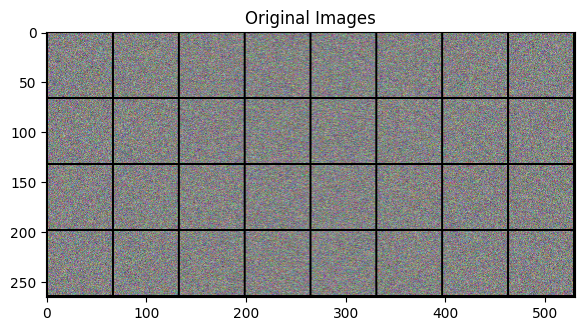

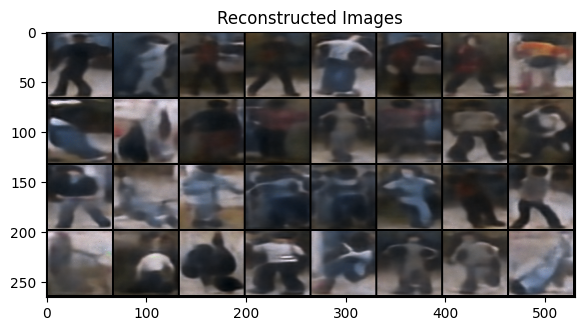

In [14]:
# Get a batch of images from your dataloader
dataiter = iter(train_abnormal_loader)  # or your specific dataloader
noise_iter = iter(noise_dataloader)

images, labels = next(dataiter)
noise = next(noise_iter)

images = images.to(device)
noise = noise.to(device)

# Forward pass through encoder and then decoder
with torch.no_grad():
    reconstructed_imgs = autoencoder(images)

plot_images_vs_reconstructed_images(noise, reconstructed_imgs)

#### Randomly initialized Teacher Autoencoder

In [14]:
# autoencoder_teacher = AvenueAutoencoder().to(device).eval()

# for param in autoencoder_teacher.parameters():
#     param.requires_grad = False

#### One-Time: UBNormal Abnormal Train 

In [30]:
import os

sys.path.append("./abnorm_event_detect/evaluation/")
os.chdir("abnorm_event_detect")

from evaluation.merge_tracks import ContinuousTrack

os.chdir("..")

import glob
from enum import Enum

In [31]:
class TrackState(Enum):
    CREATED = "created"
    UPDATED = "updated"
    CLOSED = "closed"


class Track:
    def __init__(self, start_idx=0, end_idx=None, mask=0, video_name=""):
        self.start_idx = start_idx
        self.end_idx = end_idx
        self.bboxes = {}
        self.mask = mask
        self.state = TrackState.CREATED
        self.video_name = video_name

    def __str__(self):
        return str(self.__class__) + ": " + str(self.__dict__)


class AnomalyDetection:
    def __init__(self, frame_idx, bbox, score, video_name, track_id=-1):
        self.frame_idx = frame_idx
        self.bbox = bbox
        self.score = score
        self.video_name = video_name
        self.track_id = track_id

    def __str__(self):
        return str(self.__class__) + ": " + str(self.__dict__)

In [32]:
# Import pickle file
import pickle

with open("ubnormal_all_train_gt_tracks", "rb") as file:
    all_gt_tracks = pickle.load(file)

num_tracks = len(all_gt_tracks)
print("All GT Tracks: ", num_tracks, all_gt_tracks[:2])

gt_anomalies = []
for track_id, track in enumerate(all_gt_tracks):
    for frame_idx, bbox in track.bboxes.items():
        gt_anomalies.append(
            AnomalyDetection(frame_idx, bbox, 1, track.video_name, track_id=track_id)
        )

print("GT Anomalies: ", len(gt_anomalies), gt_anomalies[:2])

All GT Tracks:  194 [<__main__.Track object at 0x7f6e1231fc40>, <__main__.Track object at 0x7f6e21973a00>]
GT Anomalies:  37040 [<__main__.AnomalyDetection object at 0x7f6de6d72ad0>, <__main__.AnomalyDetection object at 0x7f6e1234f760>]


In [33]:
gt_anomalies

 ...]

In [34]:
print(all_gt_tracks[0].video_name)
print(all_gt_tracks[0].mask)
print(all_gt_tracks[0].bboxes)

abnormal_scene_27_scenario_8
0
{374: [460, 397, 523, 527], 375: [460, 401, 520, 527], 376: [461, 405, 518, 527], 377: [462, 409, 516, 527], 378: [462, 412, 515, 527], 379: [463, 414, 515, 527], 380: [463, 416, 514, 527], 381: [463, 418, 514, 527], 382: [463, 420, 514, 528], 383: [463, 421, 514, 528], 384: [463, 422, 514, 529], 385: [462, 423, 514, 529], 386: [462, 424, 514, 529], 387: [462, 424, 514, 529], 388: [462, 425, 514, 529], 389: [462, 425, 514, 529], 390: [462, 426, 514, 529], 391: [462, 426, 514, 529], 392: [462, 426, 514, 529], 393: [462, 426, 514, 529], 394: [462, 427, 514, 529], 395: [462, 427, 514, 529], 396: [462, 427, 514, 529], 397: [462, 428, 514, 529], 398: [462, 428, 514, 529], 399: [461, 428, 515, 529], 400: [461, 429, 514, 529], 401: [461, 429, 514, 529], 402: [461, 430, 514, 529], 403: [460, 431, 514, 530], 404: [460, 432, 514, 530], 405: [459, 434, 514, 530], 406: [459, 435, 514, 530], 407: [458, 437, 514, 530], 408: [458, 440, 514, 530], 409: [457, 442, 514, 53

In [35]:
print(gt_anomalies[0].frame_idx, gt_anomalies[0].video_name, gt_anomalies[0].bbox)
print(gt_anomalies[1].frame_idx, gt_anomalies[1].video_name, gt_anomalies[1].bbox)
print(gt_anomalies[2].frame_idx, gt_anomalies[2].video_name, gt_anomalies[2].bbox)
print(gt_anomalies[3].frame_idx, gt_anomalies[3].video_name, gt_anomalies[3].bbox)

374 abnormal_scene_27_scenario_8 [460, 397, 523, 527]
375 abnormal_scene_27_scenario_8 [460, 401, 520, 527]
376 abnormal_scene_27_scenario_8 [461, 405, 518, 527]
377 abnormal_scene_27_scenario_8 [462, 409, 516, 527]


In [37]:
import pickle

with open("ubnormal_anomaly_train_labels_masks", "rb") as file:
    abnormal_train_masks = pickle.load(file)
print(abnormal_train_masks)

{'abnormal_scene_27_scenario_8': array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0,

In [38]:
len(abnormal_train_masks)

135

In [43]:
# One time for storing all anomolous objects in folder
output_path = "./datasets/UBNormal/train_anomalies_objects_all"

# Setup base paths for train anomalies
train_abnormal_frames_path = "./datasets/UBNormal/train_abnormal_frames/"

# Go through all UBNormal anomalies (37k)
for i, anomaly in enumerate(gt_anomalies):
    vid_name = anomaly.video_name
    frame_idx = anomaly.frame_idx
    bbox = anomaly.bbox

    # For each anomaly, get the right path given a base folder
    vid_path = os.path.join(train_abnormal_frames_path, vid_name)

    # Get all the image names in that folder, sort them (inefficient but functional)
    image_files = sorted(list_image_files(vid_path))

    # Get image name
    full_image_path = image_files[frame_idx]
    # print(full_image_path)

    # Read the frame
    image = Image.open(full_image_path)
    im_size = (image.size[0], image.size[1])

    # Crop the appropriate obejct
    cropped_obj = image.crop((bbox[0], bbox[1], bbox[2], bbox[3]))

    # and store it at final output path
    object_prediction_path = os.path.join(output_path, vid_name)

    save_cropped_images(
        [cropped_obj],
        object_prediction_path,
        image_prefix=f"{full_image_path.split('/')[-1].split('.')[0]}_{bbox[0]}_{bbox[1]}_{bbox[2]}_{bbox[3]}",
    )

# We should have a final folder with all the anomolous objects in train at a given path
# We want a folder with all the anomalies so that we can read it as a data loader

#### Randomly initialized Teacher CNN Autoencoder

In [12]:
autoencoder_teacher = CNNAutoencoder().to(device).eval()

for param in autoencoder_teacher.parameters():
    param.requires_grad = False

#### Training Loop

In [15]:
# Set up loss function and optimizer
criterion = nn.MSELoss()
optimizer = optim.Adam(autoencoder.parameters(), lr=0.001)
# triplet_loss = nn.TripletMarginLoss(margin=1.0, p=2)

- in timpul antrenarii am luat un batch de anomalii cu un batch de normal samples (unde normal samples sunt sub forma de cycle) si am calculat ca loss-ul abnormal ca mse intre random reconstruction si imaginile reconstruite de autoencoder, iar cu mse reconstruction apoi la sample-urile normale. Am incercat si cu si fara gradient accumulation. Am schimbat si din mse la abnormal la triplet loss, cu abnormal inputs anchor, positive random reconstructions, negative reconstruction din autoencoder pre-antrenat. Am incercat si triplet loss atat pe sample-urile anormale, cat si pe cele normale (anchor inputs, positive reconstructions, negative random reconstructions). Toate metodele au dus la rezultate mai slabe. 

In [16]:
# autoencoder.train()

# # Training loop
# num_epochs = 70  # Define the number of epochs
# losses = []
# normal_losses = []
# abnormal_losses = []
# # smallest_loss = 3
# abnormal_factor = 0.02

# for epoch in range(num_epochs):
#     running_loss = 0.0
#     normal_running_loss = 0.0
#     abnormal_running_loss = 0.0
#     print(f"--- Epoch {epoch + 1} ---")

#     # Create an iterator for normal samples and cycle through it
#     normal_iter = itertools.cycle(train_loader)
#     noise_iter = iter(noise_dataloader)

#     # Abnormal Samples
#     for abnormal_inputs, _ in train_abnormal_loader:
#         optimizer.zero_grad()

#         abnormal_inputs = abnormal_inputs.to(device)
#         reconstructed_abnormal_imgs = autoencoder(abnormal_inputs)
#         noise = next(noise_iter)

#         # Compute Loss
#         loss_abnormal = F.kl_div(F.log_softmax(reconstructed_abnormal_imgs, dim=1).to(device), F.softmax(noise, dim=1).to(device), reduction='batchmean')
#         # loss_abnormal.backward()
#         # optimizer.step()

#         abnormal_running_loss += loss_abnormal.item()
#         abnormal_losses.append(loss_abnormal.item())

#         # Normal objects batch
#         inputs, _ = next(normal_iter)
#         inputs = inputs.to(device)

#         reconstructed_imgs = autoencoder(inputs)
#         loss_normal = F.kl_div(F.log_softmax(reconstructed_imgs, dim=1).to(device), F.softmax(inputs, dim=1).to(device), reduction='batchmean')

#         # with torch.no_grad():
#         #     random_reconstructions = autoencoder_teacher(inputs)
#         # loss_normal = triplet_loss(inputs, reconstructed_imgs, random_reconstructions)

#         normal_running_loss += loss_normal.item()
#         normal_losses.append(loss_normal.item())

#         loss = abnormal_factor * loss_abnormal + loss_normal
#         loss.backward()

#         # loss_normal.backward()
#         optimizer.step()

#         # running_loss += loss.item()
#         # losses.append(loss.item())

#     print(f'Epoch {epoch+1}, Normal Loss: {normal_running_loss / len(train_loader)}')
#     print(f'Epoch {epoch+1}, Abnormal Loss: {abnormal_running_loss / len(train_abnormal_loader)}')
#     # print(f'Epoch {epoch+1}, Overall Loss: {running_loss / (len(train_abnormal_loader) + len(train_loader))}')

#     # Compute RBDC, TBDC
#     anomaly_scores_dict, all_pred_ano = compute_anomaly_reconstruction_scores(
#         autoencoder = autoencoder,
#         obj_dect_dict = obj_dect_avenue,
#         test_video_paths = test_video_paths,
#         video_names = video_names,
#         device=device,
#         verbose=False
#     )
#     compute_fpr_rbdr(all_pred_ano, gt_anomalies, all_gt_tracks, num_frames=num_frames, num_tracks=num_tracks)
#     print("Macro AUC:")
#     macro_auc, filtered_preds, filtered_labels = compute_macro_auc(anomaly_scores_dict, labels_dict)

#     print("Micro AUC:")
#     micro_auc = compute_micro_auc(filtered_preds, filtered_labels)

#     # In the case for Avenue, 0.867 is the largest micro auc within the baseline
#     if micro_auc > 0.867:
#         # Save checkpoint
#         print("!!! --- NEW BEST FOUND --- !!!")
#         checkpoint = {
#             'epoch': epoch + 1,
#             'encoder_state_dict': autoencoder.encoder.state_dict(),
#             'decoder_state_dict': autoencoder.decoder.state_dict(),
#             'optimizer_state_dict': optimizer.state_dict(),
#             'loss': running_loss / len(train_loader)
#         }
#         torch.save(checkpoint, f'autoencoder_avenue_ubnormal_adversarial_random_teacher_t12_decoder_yolov8_adamw_epoch_{epoch}_loss_{normal_running_loss / len(train_loader)}_abloss_{abnormal_running_loss / len(train_abnormal_loader)}.pth')

#     # run.log({"Loss": running_loss / len(train_loader), "epoch": epoch+1})

# print('Finished Training')
# # run.finish()

In [15]:
autoencoder.train()

# Training loop
num_epochs = 70  # Define the number of epochs
losses = []
normal_losses = []
abnormal_losses = []
# smallest_loss = 3
abnormal_factor = 0.03

for epoch in range(num_epochs):
    running_loss = 0.0
    normal_running_loss = 0.0
    abnormal_running_loss = 0.0
    print(f"--- Epoch {epoch + 1} ---")

    # Create an iterator for normal samples and cycle through it
    normal_iter = itertools.cycle(train_loader)
    noise_iter = iter(noise_dataloader)

    # Abnormal Samples
    for abnormal_inputs, _ in train_abnormal_loader:
        optimizer.zero_grad()

        abnormal_inputs = abnormal_inputs.to(device)
        reconstructed_abnormal_imgs = autoencoder(abnormal_inputs)
        noise = next(noise_iter).to(device)

        # Compute Loss for Abnormal Samples
        loss_abnormal = criterion(reconstructed_abnormal_imgs, noise)

        # Perform Gradient Ascent (i.e., negate the loss)
        loss_abnormal = -abnormal_factor * loss_abnormal
        # loss_abnormal.backward()
        abnormal_running_loss += loss_abnormal.item()

        # Normal objects batch
        inputs, _ = next(normal_iter)
        inputs = inputs.to(device)
        reconstructed_imgs = autoencoder(inputs)

        # Compute Loss for Normal Samples
        loss_normal = criterion(inputs, reconstructed_imgs)
        normal_running_loss += loss_normal.item()

        # loss_normal.backward()
        loss = loss_abnormal + loss_normal
        loss.backward()
        optimizer.step()

    print(f"Epoch {epoch+1}, Normal Loss: {normal_running_loss / len(train_loader)}")
    print(
        f"Epoch {epoch+1}, Abnormal Loss: {abnormal_running_loss / len(train_abnormal_loader)}"
    )
    # print(f'Epoch {epoch+1}, Overall Loss: {running_loss / (len(train_abnormal_loader) + len(train_loader))}')

    # Compute RBDC, TBDC
    anomaly_scores_dict, all_pred_ano = compute_anomaly_reconstruction_scores(
        autoencoder=autoencoder,
        obj_dect_dict=obj_dect_avenue,
        test_video_paths=test_video_paths,
        video_names=video_names,
        device=device,
        verbose=False,
    )
    compute_fpr_rbdr(
        all_pred_ano,
        gt_anomalies,
        all_gt_tracks,
        num_frames=num_frames,
        num_tracks=num_tracks,
    )
    print("Macro AUC:")
    macro_auc, filtered_preds, filtered_labels = compute_macro_auc(
        anomaly_scores_dict, labels_dict
    )

    print("Micro AUC:")
    micro_auc = compute_micro_auc(filtered_preds, filtered_labels)

    # In the case for Avenue, 0.867 is the largest micro auc within the baseline
    if micro_auc > 0.867:
        # Save checkpoint
        print("!!! --- NEW BEST FOUND --- !!!")
        checkpoint = {
            "epoch": epoch + 1,
            "encoder_state_dict": autoencoder.encoder.state_dict(),
            "decoder_state_dict": autoencoder.decoder.state_dict(),
            "optimizer_state_dict": optimizer.state_dict(),
            "loss": running_loss / len(train_loader),
        }
        torch.save(
            checkpoint,
            f"autoencoder_avenue_ubnormal_adversarial_random_teacher_t12_decoder_yolov8_adamw_epoch_{epoch}_loss_{normal_running_loss / len(train_loader)}_abloss_{abnormal_running_loss / len(train_abnormal_loader)}.pth",
        )

    # run.log({"Loss": running_loss / len(train_loader), "epoch": epoch+1})

print("Finished Training")
# run.finish()

In [ ]:
# autoencoder.train()

# # Training loop
# num_epochs = 30  # Define the number of epochs
# losses = []
# normal_losses = []
# abnormal_losses = []
# # smallest_loss = 3

# # # start a new wandb run to track this script
# # run = wandb.init(
# #     # set the wandb project where this run will be logged
# #     project="Anomaly Detection",

# #     # track hyperparameters and run metadata
# #     config={
# #         "task": "Adversarial Training",
# #         "encoder": "T12",
# #         "decoder": f"{decoder.__class__}",
# #         "dataset": "Avenue",
# #         "predictions": "YoloV8",
# #         "epochs": f"{num_epochs}",
# #         "input_channels": f"{input_channels}",
# #         "num_upsamples": f"{num_upsamples}",
# #         "num_blocks": f"{num_blocks}",
# #         "num_heads": f"{num_heads}",
# #         "ff_dim": f"{ff_dim}",
# #         "output_channels": f"{output_channels}"
# #     }
# # )

# for epoch in range(num_epochs):
#     running_loss = 0.0
#     normal_running_loss = 0.0
#     abnormal_running_loss = 0.0
#     print(f"--- Epoch {epoch + 1} ---")

#     # Create an iterator for normal samples and cycle through it
#     normal_iter = itertools.cycle(train_loader)

#     # Normal Samples
#     for abnormal_inputs, _ in train_abnormal_loader:
#         optimizer.zero_grad()
#         abnormal_inputs = abnormal_inputs.to(device)

#         with torch.no_grad():
#             random_reconstructions = autoencoder_teacher(abnormal_inputs)

#         reconstructed_abnormal_imgs = autoencoder(abnormal_inputs)
#         loss_abnormal = criterion(reconstructed_abnormal_imgs, random_reconstructions.to(device))

#         abnormal_running_loss += loss_abnormal.item()
#         abnormal_losses.append(loss_abnormal.item())

#         # Normal objects batch
#         inputs, _ = next(normal_iter)
#         inputs = inputs.to(device)

#         reconstructed_imgs = autoencoder(inputs)
#         loss_normal = criterion(inputs, reconstructed_imgs)

#         normal_running_loss += loss_normal.item()
#         normal_losses.append(loss_normal.item())

#         loss = loss_normal + loss_abnormal
#         loss.backward()
#         optimizer.step()

#         running_loss += loss.item()
#         losses.append(loss.item())

#     print(f'Epoch {epoch+1}, Normal Loss: {normal_running_loss / len(train_loader)}')
#     print(f'Epoch {epoch+1}, Abnormal Loss: {abnormal_running_loss / len(train_abnormal_loader)}')
#     print(f'Epoch {epoch+1}, Overall Loss: {running_loss / (len(train_abnormal_loader) + len(train_loader))}')

#     # Save checkpoint
#     checkpoint = {
#         'epoch': epoch + 1,
#         'encoder_state_dict': autoencoder.encoder.state_dict(),
#         'decoder_state_dict': autoencoder.decoder.state_dict(),
#         'optimizer_state_dict': optimizer.state_dict(),
#         'loss': running_loss / len(train_loader)
#     }
#     torch.save(checkpoint, f'autoencoder_avenue_ubnormal_adversarial_random_teacher_t12_decoder_yolov8_adamw_epoch_{epoch}_loss_{running_loss / len(train_loader)}_abloss_{abnormal_running_loss / len(train_abnormal_loader)}.pth')

#     # run.log({"Loss": running_loss / len(train_loader), "epoch": epoch+1})

# print('Finished Training')
# # run.finish()

In [35]:
# Get a batch of images from your dataloader
dataiter = iter(train_abnormal_loader)  # or your specific dataloader
images, labels = next(dataiter)
images = images.to(device)

# Forward pass through encoder and then decoder
with torch.no_grad():
    reconstructed_imgs = autoencoder_teacher(images)

plot_images_vs_reconstructed_images(images, reconstructed_imgs)

NameError: name 'autoencoder_teacher' is not defined

In [17]:
reconstructed_imgs[1]

tensor([[[-0.1073,  0.1696,  0.1201,  ...,  0.6871,  0.6315,  0.4611],
         [ 0.1864,  0.5255,  0.5227,  ...,  0.7912,  0.7454,  0.3441],
         [ 0.3123,  0.5112,  0.5138,  ...,  0.8794,  0.8013,  0.1798],
         ...,
         [ 0.1944, -0.3567, -0.2271,  ...,  0.6541,  0.5878,  0.9054],
         [ 0.1294, -0.3192, -0.1793,  ...,  0.6604,  0.5856,  0.8834],
         [ 0.1174, -0.2657, -0.0254,  ...,  0.7147,  0.7116,  0.8959]],

        [[-0.1691,  0.1749,  0.4213,  ...,  0.1866,  0.1531,  0.1984],
         [-0.2315,  0.1193,  0.1711,  ...,  0.4377,  0.3674,  0.5479],
         [-0.1905,  0.1214,  0.1561,  ...,  0.5288,  0.3980,  0.3676],
         ...,
         [ 0.0189, -0.2728, -0.2875,  ...,  0.2227,  0.2616,  0.5181],
         [ 0.0339, -0.3504, -0.3662,  ...,  0.1920,  0.2756,  0.4776],
         [ 0.7775,  0.2728,  0.4346,  ...,  0.3007,  0.4445,  0.4893]],

        [[ 0.2364, -0.0659, -0.0730,  ..., -0.1569, -0.0443,  0.2282],
         [-0.0272, -0.2977, -0.2140,  ..., -0

In [18]:
reconstructed_imgs[0]

tensor([[[-0.1073,  0.1696,  0.1201,  ...,  0.6871,  0.6315,  0.4611],
         [ 0.1864,  0.5255,  0.5227,  ...,  0.7913,  0.7454,  0.3441],
         [ 0.3123,  0.5112,  0.5138,  ...,  0.8794,  0.8013,  0.1798],
         ...,
         [ 0.1944, -0.3567, -0.2271,  ...,  0.6541,  0.5878,  0.9054],
         [ 0.1294, -0.3192, -0.1793,  ...,  0.6604,  0.5856,  0.8834],
         [ 0.1174, -0.2657, -0.0254,  ...,  0.7147,  0.7116,  0.8959]],

        [[-0.1691,  0.1749,  0.4213,  ...,  0.1866,  0.1531,  0.1984],
         [-0.2315,  0.1193,  0.1711,  ...,  0.4377,  0.3674,  0.5479],
         [-0.1905,  0.1214,  0.1561,  ...,  0.5288,  0.3980,  0.3676],
         ...,
         [ 0.0189, -0.2728, -0.2875,  ...,  0.2227,  0.2616,  0.5181],
         [ 0.0339, -0.3504, -0.3662,  ...,  0.1920,  0.2756,  0.4776],
         [ 0.7775,  0.2728,  0.4346,  ...,  0.3007,  0.4445,  0.4893]],

        [[ 0.2364, -0.0659, -0.0730,  ..., -0.1569, -0.0443,  0.2282],
         [-0.0272, -0.2977, -0.2140,  ..., -0

In [20]:
torch.eq(reconstructed_imgs[0], reconstructed_imgs[1])

tensor([[[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False]],

        [[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False]],

        [[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False, False, False],
         [

# Expreriment 3 - Adversarial Training using Centroid on Anomaly K-Means

## Avenue

In [7]:
test_dir = "./datasets/Avenue Dataset/test__/"
test_video_dirs = [
    "01",
    "02",
    "03",
    "04",
    "05",
    "06",
    "07",
    "08",
    "09",
    "10",
    "11",
    "12",
    "13",
    "14",
    "15",
    "16",
    "17",
    "18",
    "19",
    "20",
    "21",
]
test_video_paths = []
total_frames = 0
for dir in test_video_dirs:
    cur_dir = os.path.join(test_dir, dir)
    test_video_paths.append(cur_dir)
    jpg_files = [f for f in os.listdir(cur_dir) if f.endswith(".jpg")]
    total_frames += len(jpg_files)
    # print(cur_dir, len(jpg_files))
# print(f"Total Frames: {total_frames}")
num_frames = total_frames

image_names = [img.split("/")[-1] for img in list_image_files(test_video_paths[-1])]
video_names = [video.split("/")[-1] for video in test_video_paths]

path = "./tracks/tracks_avenue/"
video_names = [
    file.split("/")[-1].split(".")[0] for file in list_files(path) if "cont" not in file
]
pkl_files = [file for file in list_files(path) if "cont" not in file]

In [8]:
# Get GT for RBDC and TBDC
all_gt_tracks = []
num_tracks = 0

for vn, pkl_file in zip(video_names, pkl_files):
    tracks = pickle.load(open(os.path.join(pkl_file), "rb"))
    all_gt_tracks += tracks

num_tracks = len(all_gt_tracks)
print("All GT Tracks: ", num_tracks, all_gt_tracks[:2])

gt_anomalies = []
for track_id, track in enumerate(all_gt_tracks):
    for frame_idx, bbox in track.bboxes.items():
        gt_anomalies.append(
            AnomalyDetection(frame_idx, bbox, 1, track.video_name, track_id=track_id)
        )

print("GT Anomalies: ", len(gt_anomalies), gt_anomalies[:2])

All GT Tracks:  121 [<evaluation.track.Track object at 0x7fb26c1e4d30>, <evaluation.track.Track object at 0x7fb26c1e7010>]
GT Anomalies:  3914 [<anomaly_detection_utils.AnomalyDetection object at 0x7fb26c1e4d60>, <anomaly_detection_utils.AnomalyDetection object at 0x7fb26c1e47f0>]


In [9]:
obj_detections_and_optical_flow_pkl_path = (
    "obj_dect_0.86_avenue_optical_flow_raft_thresh_200_minarea_200_iou_0.8"
)
obj_dect_avenue = load_artefact(obj_detections_and_optical_flow_pkl_path)

labels_path = "./datasets/Avenue Dataset/gt/"
labels_dict = {}

for vid_name in video_names:
    labels_dict[vid_name] = read_txt_to_numpy_array(
        os.path.join(labels_path, f"{vid_name}.txt")
    )
print(np.array(labels_dict["01"]))

[0. 0. 0. ... 0. 0. 0.]


In [10]:
labels_path = "./datasets/Avenue Dataset/gt/"
labels_dict = {}

for vid_name in video_names:
    labels_dict[vid_name] = read_txt_to_numpy_array(
        os.path.join(labels_path, f"{vid_name}.txt")
    )
print(np.array(labels_dict["01"]))

[0. 0. 0. ... 0. 0. 0.]


#### Normal Train Objects

In [11]:
torch.manual_seed(0)
train_dataset = datasets.ImageFolder(
    root="./datasets/Avenue Dataset/objects/train/", transform=transform
)

# Create the DataLoader to load the dataset.
batch_size = 32
train_loader = DataLoader(
    train_dataset, batch_size=batch_size, shuffle=True, num_workers=2, drop_last=True
)

print(train_dataset)

Dataset ImageFolder
    Number of datapoints: 127194
    Root location: ./datasets/Avenue Dataset/objects/train/
    StandardTransform
Transform: Compose(
               Resize(size=(64, 64), interpolation=bilinear, max_size=None, antialias=None)
               ToTensor()
               Normalize(mean=0.5, std=0.5)
           )


#### Abnormal Train Objects

In [12]:
# anomalies_path = './datasets/UBNormal/train_anomalies_objects_all/'
anomalies_path = "./datasets/UBNormal/train_anomalies_avenue_background_objects/"
train_abnormal_dataset = datasets.ImageFolder(root=anomalies_path, transform=transform)
train_abnormal_loader = DataLoader(
    train_abnormal_dataset,
    batch_size=batch_size,
    shuffle=True,
    num_workers=2,
    drop_last=True,
)
print(train_abnormal_dataset)

Dataset ImageFolder
    Number of datapoints: 12965
    Root location: ./datasets/UBNormal/train_anomalies_avenue_background_objects/
    StandardTransform
Transform: Compose(
               Resize(size=(64, 64), interpolation=bilinear, max_size=None, antialias=None)
               ToTensor()
               Normalize(mean=0.5, std=0.5)
           )


### Exp 1: Compute single centroid on normal samples, and try to minimize distance on latent representations, and to expand distance on abnormal samples

In [13]:
# %%time
# # TODO ulterior: Sa il fortez sa mearga catre cluster-ul predeterminat, sa am un dict cu imagine si latent representation pt K-Means
# latent_representations = None
# autoencoder.eval()

# print("Computing Latents for K-Means...")
# with torch.no_grad():
#     for inputs, _ in train_loader:
#         inputs = inputs.to(device)

#         # Forward pass through the encoder
#         latents = autoencoder.encoder(inputs)

#         last_latent_tensor = latents[-1]

#         # Pot sa fac flatten
#         flattened_batch_last = last_latent_tensor.view(last_latent_tensor.size(0), -1).detach().cpu().numpy()

#         # Initialize or concatenate the results (numpy append is actually slower)
#         if latent_representations is None:
#             # latent_representations = concatenated_batch
#             latent_representations = flattened_batch_last
#         else:
#             # latent_representations = np.concatenate((latent_representations, concatenated_batch), axis=0)
#             latent_representations = np.concatenate((latent_representations, flattened_batch_last), axis=0)

#         # del inputs
#         # torch.cuda.empty_cache()

# print(latent_representations.shape)

In [14]:
# %%time
# # del latents
# # torch.cuda.empty_cache()  # Clear unused memory
# num_clusters = 1
# # Perform K-means on these representations
# # kmeans = KMeans(n_clusters=500, random_state=0, n_init="auto")
# kmeans = KMeans(n_clusters=num_clusters, random_state=707, n_init="auto")
# kmeans.fit(latent_representations)
# cluster_labels = kmeans.labels_
# cluster_centers = kmeans.cluster_centers_ # (50, 2048) -> ii las in numpy

In [15]:
# import pickle
# # Specify the file name for storing the array


# # Open the file in write-binary ('wb') mode and use pickle to dump the array
# with open(file_name, 'wb') as file:
#     pickle.dump(kmeans, file)
# print(f"K-Means successfully saved to {file_name}")

In [16]:
# Load object
num_clusters = 1
pickle_file_path = f"avenue_kmeans_{num_clusters}_2048.pkl"

# Open the file in binary read mode
with open(pickle_file_path, "rb") as file:
    # Load the contents from the file
    kmeans = pickle.load(file)

cluster_labels = kmeans.labels_
cluster_centers = kmeans.cluster_centers_  # (50, 2048) -> ii las in numpy
# Now you can use 'data' which holds the contents of your pickle file
print(kmeans)

KMeans(n_clusters=1, n_init='auto', random_state=707)


In [17]:
cluster_labels.shape

(127168,)

In [18]:
cluster_centers.shape

(1, 2048)

In [19]:
criterion = nn.MSELoss()
optimizer = optim.Adam(autoencoder.parameters(), lr=0.001)

#### Vizualizations of Reconstruction & Latent Representations

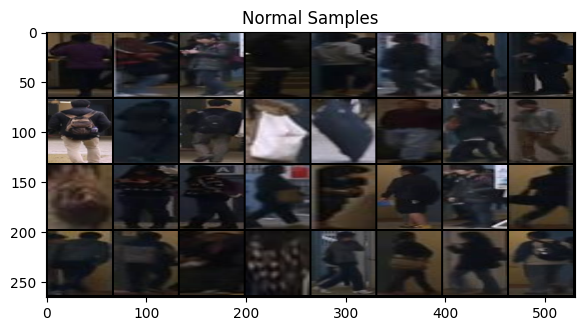

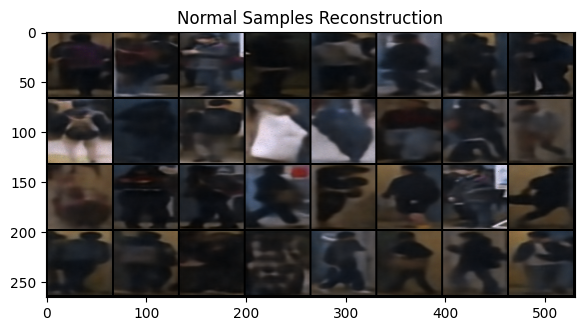

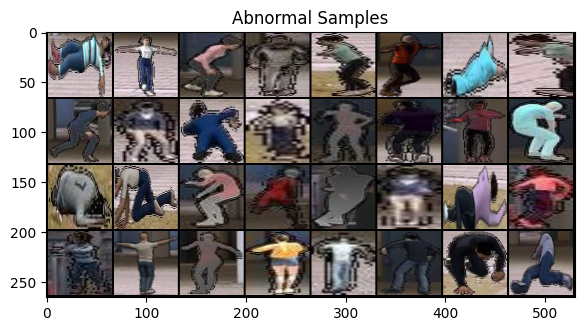

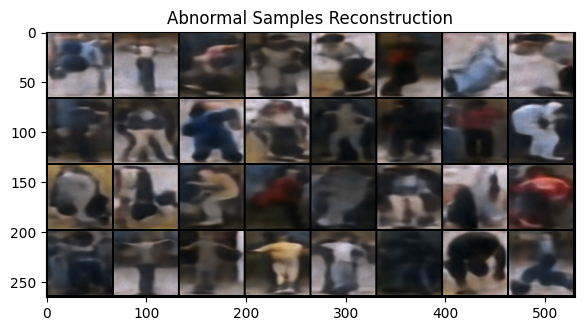

In [20]:
# Plot Normal and Abnormal Samples before training

# Get a batch of images from your dataloader
ab_dataiter = iter(train_abnormal_loader)  # or your specific dataloader
dataiter = iter(train_loader)

ab_images, _ = next(ab_dataiter)
images, _ = next(dataiter)

ab_images = ab_images.to(device)
images = images.to(device)

# Forward pass through encoder and then decoder
with torch.no_grad():
    reconstructed_imgs = autoencoder(images)
    reconstructed_ab_imgs = autoencoder(ab_images)

plot_images_vs_reconstructed_images(
    images,
    reconstructed_imgs,
    first_batch_title="Normal Samples",
    second_batch_title="Normal Samples Reconstruction",
)

plot_images_vs_reconstructed_images(
    ab_images,
    reconstructed_ab_imgs,
    first_batch_title="Abnormal Samples",
    second_batch_title="Abnormal Samples Reconstruction",
)

In [21]:
# Plot example normal and abnormal latent representations before training
latents = autoencoder.encoder(images)
last_latent_tensor = latents[-1]  # [batch_size, 512, 2, 2]
last_latent_tensor.shape
# plot_latent_representations(last_latent_tensor)

latents = autoencoder.encoder(ab_images)
last_latent_tensor = latents[-1]  # [batch_size, 512, 2, 2]
last_latent_tensor.shape
# plot_latent_representations(last_latent_tensor)

torch.Size([32, 512, 2, 2])

In [22]:
%%time
# Plot all abnormal samples
latent_representations = None

for abnormal_inputs, _ in train_abnormal_loader:
    abnormal_inputs = abnormal_inputs.to(device)

    latents = autoencoder.encoder(abnormal_inputs)
    # last_latent_tensor = latents[-1].view(last_latent_tensor.size(0), -1).detach().cpu() # [batch_size, 512, 2, 2]
    last_latent_tensor = latents[-1].detach().cpu()

    # Initialize or concatenate the results (numpy append is actually slower)
    if latent_representations is None:
        # latent_representations = concatenated_batch
        latent_representations = last_latent_tensor
    else:
        # latent_representations = np.concatenate((latent_representations, concatenated_batch), axis=0)
        latent_representations = torch.cat(
            (latent_representations, last_latent_tensor), axis=0
        )

print(f"After Abnormal: {latent_representations.shape}")

for inputs, _ in train_loader:
    inputs = inputs.to(device)

    latents = autoencoder.encoder(inputs)
    # last_latent_tensor = latents[-1].view(last_latent_tensor.size(0), -1).detach().cpu() # [batch_size, 512, 2, 2]
    last_latent_tensor = latents[-1].detach().cpu()

    # Initialize or concatenate the results (numpy append is actually slower)
    if latent_representations is None:
        # latent_representations = concatenated_batch
        latent_representations = last_latent_tensor
    else:
        # latent_representations = np.concatenate((latent_representations, concatenated_batch), axis=0)
        latent_representations = torch.cat(
            (latent_representations, last_latent_tensor), axis=0
        )

print(f"Total: {latent_representations.shape}")

After Abnormal: torch.Size([12960, 512, 2, 2])
Total: torch.Size([140128, 512, 2, 2])
CPU times: user 7min 59s, sys: 9min 29s, total: 17min 28s
Wall time: 4min 10s


In [23]:
latent_representations.shape

torch.Size([140128, 512, 2, 2])

In [24]:
import torch
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D


def plot_latent_representations(
    tensor: torch.tensor,
    split_index: int,
    elevation: int = 30,  # Angle of elevation in degrees
    azimuth: int = 30,  # Rotation around the z-axis in degrees
    title: str = "3D Scatter Plot of Latent Space",
) -> None:
    # Flattening the tensor except for the batch dimension
    flattened_tensor = tensor.view(tensor.size(0), -1).detach().cpu()

    x = flattened_tensor[:, 0].numpy()
    y = flattened_tensor[:, 1].numpy()
    z = flattened_tensor[:, 2].numpy()

    fig = plt.figure()
    ax = fig.add_subplot(111, projection="3d")

    # Scatter the first 'split_index' entries in one color (e.g., 'red')
    ax.scatter(
        x[:split_index], y[:split_index], z[:split_index], c="red", label="Abnormal"
    )

    # Scatter the rest in another color (e.g., 'blue')
    ax.scatter(
        x[split_index:], y[split_index:], z[split_index:], c="blue", label="Normal"
    )

    ax.set_xlabel("512-dim (1st)")
    ax.set_ylabel("2-dim (2nd)")
    ax.set_zlabel("2-dim (3rd)")
    ax.set_title(title)
    ax.legend()

    # Set viewing angle
    ax.view_init(elev=elevation, azim=azimuth)

    plt.show()

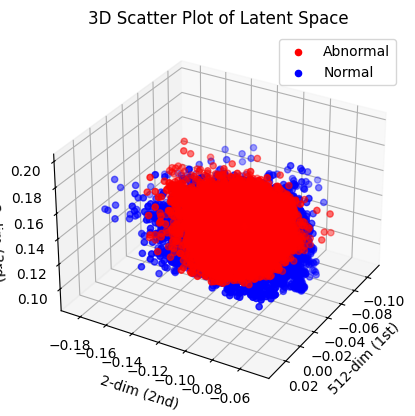

In [25]:
%matplotlib inline
plot_latent_representations(
    latent_representations,
    split_index=12960,
)

In [27]:
import plotly.graph_objects as go


def plot_latent_representations_plotly(tensor, title="3D Scatter Plot of Latent Space"):
    flattened_tensor = tensor.view(tensor.size(0), -1).detach().cpu()

    x = flattened_tensor[:, 0].numpy()
    y = flattened_tensor[:, 1].numpy()
    z = flattened_tensor[:, 2].numpy()

    fig = go.Figure(
        data=[go.Scatter3d(x=x, y=y, z=z, mode="markers", marker=dict(size=5))]
    )
    fig.update_layout(
        title=title,
        scene=dict(xaxis_title="X Axis", yaxis_title="Y Axis", zaxis_title="Z Axis"),
    )
    fig.show()

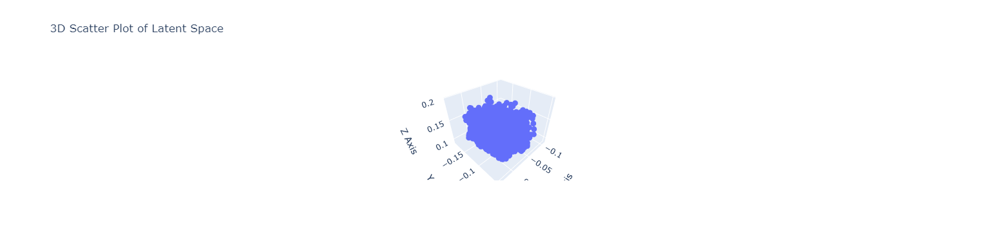

In [28]:
# %matplotlib widget
plot_latent_representations_plotly(
    latent_representations,
)

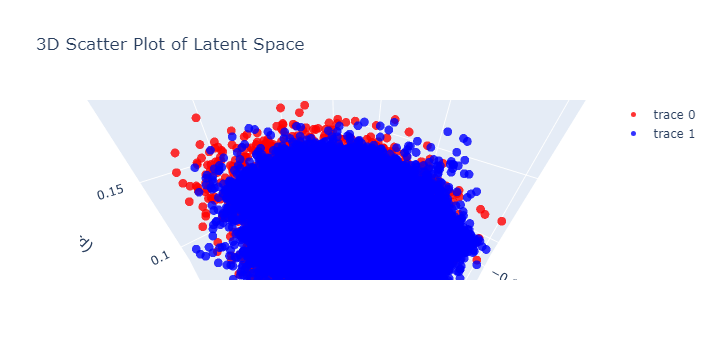

In [33]:
import plotly.graph_objects as go


# Function to plot latent representations with different colors for different index ranges
def plot_latent_representations_with_colors(
    tensor, split_index, title="3D Scatter Plot of Latent Space"
):
    # Flattening the tensor except for the batch dimension
    flattened_tensor = tensor.view(tensor.size(0), -1).detach().cpu()

    # Extracting the first three dimensions for plotting
    x = flattened_tensor[:, 0].numpy()
    y = flattened_tensor[:, 1].numpy()
    z = flattened_tensor[:, 2].numpy()

    # Split the data into two parts based on the split_index
    x1, y1, z1 = x[:split_index], y[:split_index], z[:split_index]
    x2, y2, z2 = x[split_index:], y[split_index:], z[split_index:]

    # Create traces for each split
    trace1 = go.Scatter3d(
        x=x1,
        y=y1,
        z=z1,
        mode="markers",
        marker=dict(size=5, color="red", opacity=0.8),  # First part color
    )

    trace2 = go.Scatter3d(
        x=x2,
        y=y2,
        z=z2,
        mode="markers",
        marker=dict(size=5, color="blue", opacity=0.8),  # Second part color
    )

    # Define layout
    layout = go.Layout(
        title=title,
        scene=dict(
            xaxis=dict(title="512-dim (1st)"),
            yaxis=dict(title="2-dim (2nd)"),
            zaxis=dict(title="2-dim (3rd)"),
        ),
    )

    # Create figure and add traces
    fig = go.Figure(data=[trace1, trace2], layout=layout)

    # Show plot
    fig.show()


# Example usage
plot_latent_representations_with_colors(latent_representations, split_index=12960)

#### Train Loop 

In [ ]:
cluster_centers_tensor = torch.Tensor(cluster_centers).float().to(device)
autoencoder.train()

# Training loop
num_epochs = 70  # Define the number of epochs
losses = []
normal_losses = []
abnormal_losses = []
# smallest_loss = 3
factor = 0.2

for epoch in range(num_epochs):
    running_loss = 0.0
    normal_running_loss = 0.0
    abnormal_running_loss = 0.0
    print(f"--- Epoch {epoch + 1} ---")

    # Create an iterator for normal samples and cycle through it
    normal_iter = itertools.cycle(train_loader)

    # Abnormal Samples
    for abnormal_inputs, _ in train_abnormal_loader:
        optimizer.zero_grad()

        # Normal objects batch
        inputs, _ = next(normal_iter)
        inputs = inputs.to(device)

        # Compute latent representations normal objects
        latents = autoencoder.encoder(inputs)
        last_latent_tensor = latents[-1]  # [batch_size, 512, 2, 2]
        last_latent_tensor_np = (
            last_latent_tensor.view(last_latent_tensor.size(0), -1)
            .detach()
            .cpu()
            .numpy()
        )

        # Compute latent representation loss
        embedding_space_loss = criterion(
            last_latent_tensor,
            cluster_centers_tensor.view(1, 512, 2, 2).expand_as(last_latent_tensor),
        )

        # Compute reconstruction loss
        reconstructed_imgs = autoencoder.decoder(last_latent_tensor)
        reconstruction_loss = criterion(inputs, reconstructed_imgs)

        # Compute Loss for Normal Samples
        loss_normal = factor * embedding_space_loss + reconstruction_loss
        normal_running_loss += loss_normal.item()

        # Take abnormal and normal inputs and get latent representation
        abnormal_inputs = abnormal_inputs.to(device)

        latents_ab = autoencoder.encoder(abnormal_inputs)
        last_latent_tensor_ab = latents_ab[-1]  # [batch_size, 512, 2, 2]
        last_latent_tensor_ab_np = (
            last_latent_tensor_ab.view(last_latent_tensor_ab.size(0), -1)
            .detach()
            .cpu()
            .numpy()
        )

        # Compute latent representation abnormal loss
        loss_abnormal = factor * (
            1
            - criterion(
                last_latent_tensor_ab,
                cluster_centers_tensor.view(1, 512, 2, 2).expand_as(
                    last_latent_tensor_ab
                ),
            )
        )
        abnormal_running_loss += loss_abnormal.item()

        # loss_normal.backward()
        loss = loss_abnormal + loss_normal
        loss.backward()
        optimizer.step()

    print(f"Epoch {epoch+1}, Normal Loss: {normal_running_loss / len(train_loader)}")
    print(
        f"Epoch {epoch+1}, Abnormal Loss: {abnormal_running_loss / len(train_abnormal_loader)}"
    )
    # print(f'Epoch {epoch+1}, Overall Loss: {running_loss / (len(train_abnormal_loader) + len(train_loader))}')

    # Compute RBDC, TBDC
    anomaly_scores_dict, all_pred_ano = compute_anomaly_reconstruction_scores(
        autoencoder=autoencoder,
        obj_dect_dict=obj_dect_avenue,
        test_video_paths=test_video_paths,
        video_names=video_names,
        device=device,
        verbose=False,
    )
    compute_fpr_rbdr(
        all_pred_ano,
        gt_anomalies,
        all_gt_tracks,
        num_frames=num_frames,
        num_tracks=num_tracks,
    )
    print("Macro AUC:")
    macro_auc, filtered_preds, filtered_labels = compute_macro_auc(
        anomaly_scores_dict, labels_dict
    )

    print("Micro AUC:")
    micro_auc = compute_micro_auc(filtered_preds, filtered_labels)

    # In the case for Avenue, 0.867 is the largest micro auc within the baseline
    if micro_auc > 0.867:
        # Save checkpoint
        print("!!! --- NEW BEST FOUND --- !!!")
        checkpoint = {
            "epoch": epoch + 1,
            "encoder_state_dict": autoencoder.encoder.state_dict(),
            "decoder_state_dict": autoencoder.decoder.state_dict(),
            "optimizer_state_dict": optimizer.state_dict(),
            "loss": running_loss / len(train_loader),
        }
        torch.save(
            checkpoint,
            f"autoencoder_avenue_ubnormal_adversarial_random_teacher_t12_decoder_yolov8_adamw_epoch_{epoch}_loss_{normal_running_loss / len(train_loader)}_abloss_{abnormal_running_loss / len(train_abnormal_loader)}.pth",
        )

    # run.log({"Loss": running_loss / len(train_loader), "epoch": epoch+1})

print("Finished Training")
# run.finish()

### Exp 2: Compute single centroid on abnormal samples, and try to minimize distance on latent representations, and to expand distance on normal samples

In [12]:
%%time
# TODO ulterior: Sa il fortez sa mearga catre cluster-ul predeterminat, sa am un dict cu imagine si latent representation pt K-Means
latent_ab_representations = None
autoencoder.eval()

print("Computing Latents for K-Means...")
with torch.no_grad():
    for inputs, _ in train_abnormal_loader:
        inputs = inputs.to(device)

        # Forward pass through the encoder
        latents = autoencoder.encoder(inputs)

        last_latent_tensor = latents[-1]

        # Pot sa fac flatten
        flattened_batch_last = (
            last_latent_tensor.view(last_latent_tensor.size(0), -1)
            .detach()
            .cpu()
            .numpy()
        )

        # Initialize or concatenate the results (numpy append is actually slower)
        if latent_ab_representations is None:
            # latent_representations = concatenated_batch
            latent_ab_representations = flattened_batch_last
        else:
            # latent_representations = np.concatenate((latent_representations, concatenated_batch), axis=0)
            latent_ab_representations = np.concatenate(
                (latent_ab_representations, flattened_batch_last), axis=0
            )

        # del inputs
        # torch.cuda.empty_cache()

print(latent_ab_representations.shape)

Computing Latents for K-Means...
(12960, 2048)
CPU times: user 5.52 s, sys: 1.94 s, total: 7.46 s
Wall time: 18.4 s


In [13]:
%%time
# del latents
# torch.cuda.empty_cache()  # Clear unused memory
num_clusters = 1
# Perform K-means on these representations
# kmeans = KMeans(n_clusters=500, random_state=0, n_init="auto")
kmeans = KMeans(n_clusters=num_clusters, random_state=707, n_init="auto")
kmeans.fit(latent_ab_representations)
cluster_labels = kmeans.labels_
cluster_centers = kmeans.cluster_centers_  # (50, 2048) -> ii las in numpy

CPU times: user 411 ms, sys: 1.34 s, total: 1.75 s
Wall time: 308 ms


In [14]:
import pickle

# Specify the file name for storing the array
file_name = f"avenue_kmeans_ab_{num_clusters}_2048.pkl"

# Open the file in write-binary ('wb') mode and use pickle to dump the array
with open(file_name, "wb") as file:
    pickle.dump(kmeans, file)
print(f"K-Means successfully saved to {file_name}")

K-Means successfully saved to avenue_kmeans_ab_1_2048.pkl


In [15]:
cluster_labels.shape

(12960,)

In [16]:
cluster_centers.shape

(1, 2048)

In [17]:
criterion = nn.MSELoss()
optimizer = optim.Adam(autoencoder.parameters(), lr=0.001)

In [ ]:
cluster_centers_tensor = torch.Tensor(cluster_centers).float().to(device)
autoencoder.train()

# Training loop
num_epochs = 70  # Define the number of epochs
losses = []
normal_losses = []
abnormal_losses = []
# smallest_loss = 3
factor = 0.2

for epoch in range(num_epochs):
    running_loss = 0.0
    normal_running_loss = 0.0
    abnormal_running_loss = 0.0
    print(f"--- Epoch {epoch + 1} ---")

    # Create an iterator for normal samples and cycle through it
    normal_iter = itertools.cycle(train_loader)

    # Abnormal Samples
    for abnormal_inputs, _ in train_abnormal_loader:
        optimizer.zero_grad()

        # Normal objects batch
        inputs, _ = next(normal_iter)
        inputs = inputs.to(device)

        # Compute latent representations normal objects
        latents = autoencoder.encoder(inputs)
        last_latent_tensor = latents[-1]  # [batch_size, 512, 2, 2]
        last_latent_tensor_np = (
            last_latent_tensor.view(last_latent_tensor.size(0), -1)
            .detach()
            .cpu()
            .numpy()
        )

        # Compute latent representation loss
        embedding_space_loss = criterion(
            last_latent_tensor,
            cluster_centers_tensor.view(1, 512, 2, 2).expand_as(last_latent_tensor),
        )

        # Compute reconstruction loss
        reconstructed_imgs = autoencoder.decoder(last_latent_tensor)
        reconstruction_loss = criterion(inputs, reconstructed_imgs)

        # Compute Loss for Normal Samples
        loss_normal = -factor * embedding_space_loss + reconstruction_loss
        normal_running_loss += loss_normal.item()

        # Take abnormal and normal inputs and get latent representation
        abnormal_inputs = abnormal_inputs.to(device)

        latents_ab = autoencoder.encoder(abnormal_inputs)
        last_latent_tensor_ab = latents_ab[-1]  # [batch_size, 512, 2, 2]
        last_latent_tensor_ab_np = (
            last_latent_tensor_ab.view(last_latent_tensor_ab.size(0), -1)
            .detach()
            .cpu()
            .numpy()
        )

        # Compute latent representation abnormal loss
        loss_abnormal = factor * criterion(
            last_latent_tensor_ab,
            cluster_centers_tensor.view(1, 512, 2, 2).expand_as(last_latent_tensor_ab),
        )
        abnormal_running_loss += loss_abnormal.item()

        # loss_normal.backward()
        loss = loss_abnormal + loss_normal
        loss.backward()
        optimizer.step()

    print(f"Epoch {epoch+1}, Normal Loss: {normal_running_loss / len(train_loader)}")
    print(
        f"Epoch {epoch+1}, Abnormal Loss: {abnormal_running_loss / len(train_abnormal_loader)}"
    )
    # print(f'Epoch {epoch+1}, Overall Loss: {running_loss / (len(train_abnormal_loader) + len(train_loader))}')

    # Compute RBDC, TBDC
    anomaly_scores_dict, all_pred_ano = compute_anomaly_reconstruction_scores(
        autoencoder=autoencoder,
        obj_dect_dict=obj_dect_avenue,
        test_video_paths=test_video_paths,
        video_names=video_names,
        device=device,
        verbose=False,
    )
    compute_fpr_rbdr(
        all_pred_ano,
        gt_anomalies,
        all_gt_tracks,
        num_frames=num_frames,
        num_tracks=num_tracks,
    )
    print("Macro AUC:")
    macro_auc, filtered_preds, filtered_labels = compute_macro_auc(
        anomaly_scores_dict, labels_dict
    )

    print("Micro AUC:")
    micro_auc = compute_micro_auc(filtered_preds, filtered_labels)

    # In the case for Avenue, 0.867 is the largest micro auc within the baseline
    if micro_auc > 0.867:
        # Save checkpoint
        print("!!! --- NEW BEST FOUND --- !!!")
        checkpoint = {
            "epoch": epoch + 1,
            "encoder_state_dict": autoencoder.encoder.state_dict(),
            "decoder_state_dict": autoencoder.decoder.state_dict(),
            "optimizer_state_dict": optimizer.state_dict(),
            "loss": running_loss / len(train_loader),
        }
        torch.save(
            checkpoint,
            f"autoencoder_avenue_ubnormal_adversarial_random_teacher_t12_decoder_yolov8_adamw_epoch_{epoch}_loss_{normal_running_loss / len(train_loader)}_abloss_{abnormal_running_loss / len(train_abnormal_loader)}.pth",
        )

    # run.log({"Loss": running_loss / len(train_loader), "epoch": epoch+1})

print("Finished Training")
# run.finish()

# End of Notebook